In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 5
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-3*energy_span, 3*energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ω + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N =2**9
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:06<00:00, 76.58it/s]


In [ ]:
v_rel(80e3)/c

np.float64(0.48831388230429695)

In [ ]:
v0 = v_rel(80e3)
E0 = E_rel(v0)

In [ ]:
v0

np.float64(146392819.0515279)

In [ ]:
E0

np.float64(1.1945893963335149e-14)

In [ ]:
E0/e

np.float64(74560.40557470238)

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1
L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1 = final_state_probability_density(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

ValueError: too many values to unpack (expected 7)

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1
L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

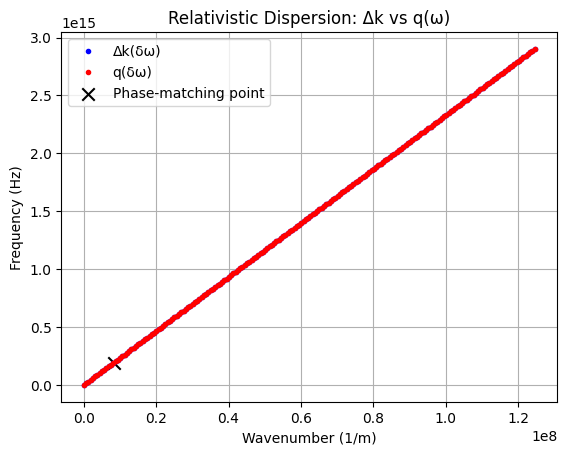

In [ ]:
# Plot Δk(δω) and q(δω) for SEM setup
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)

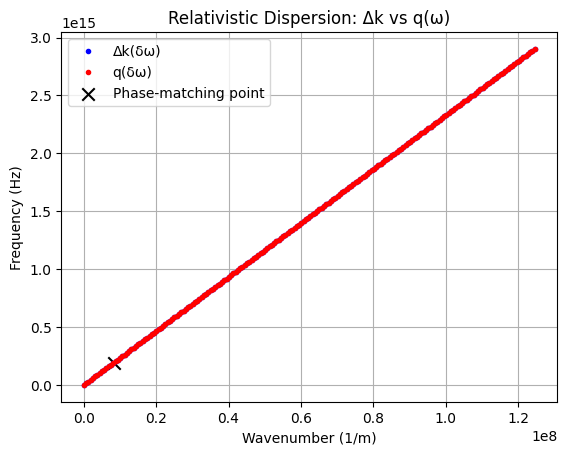

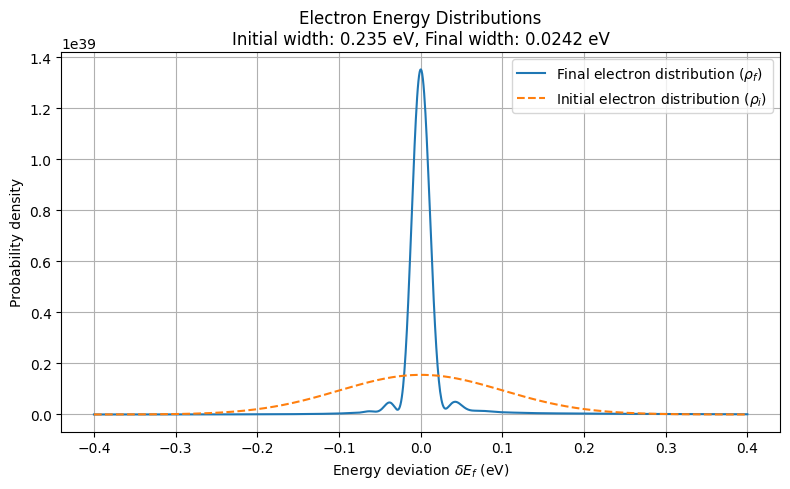

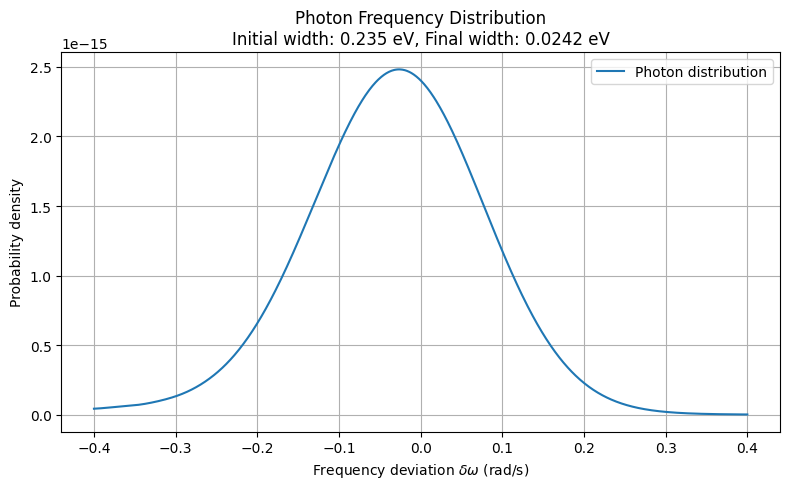

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = 80e3 #E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1
L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

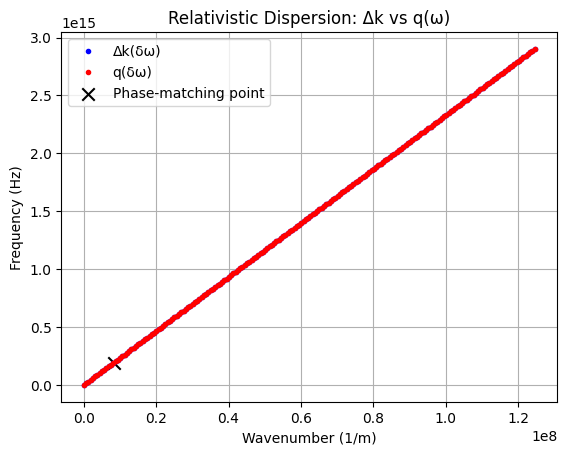

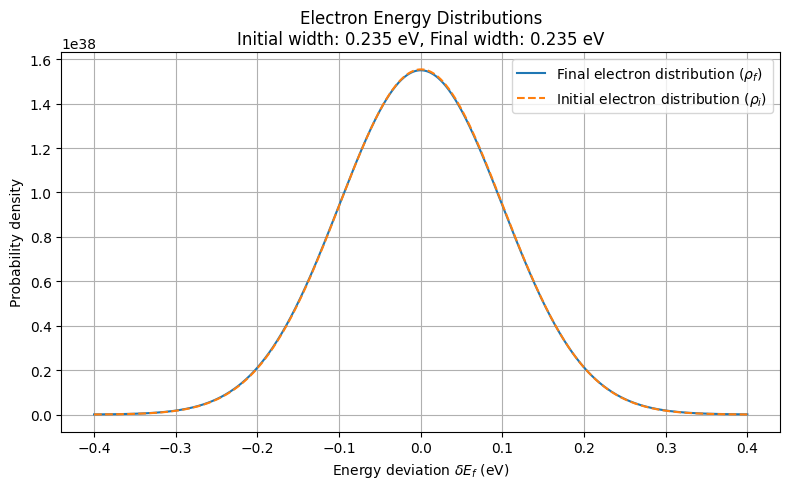

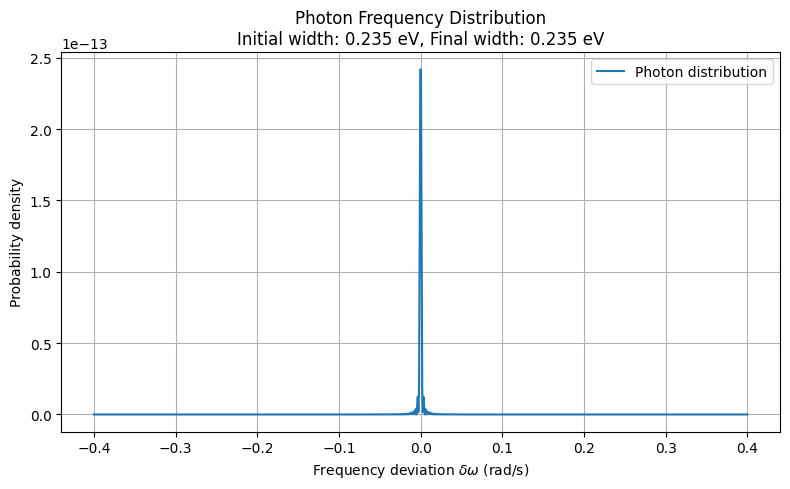

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1
L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:21<00:00, 47.05it/s]


In [ ]:
k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

SyntaxError: unmatched ')' (<ipython-input-29-c0d4119a86bd>, line 2)

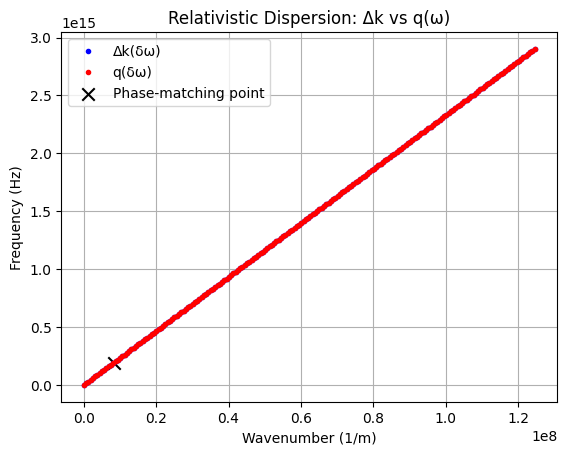

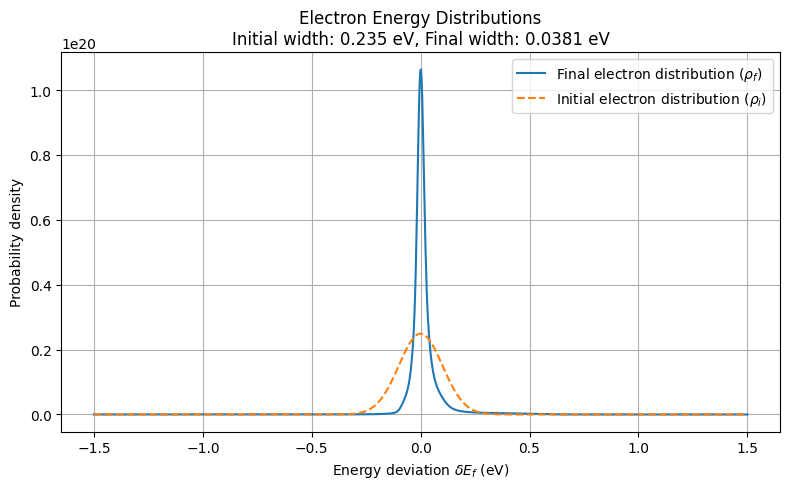

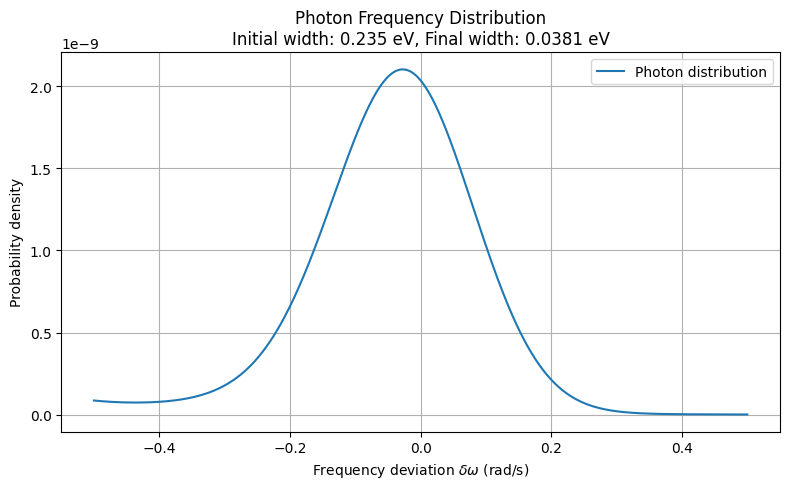

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 5
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ω + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1
L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:20<00:00, 51.09it/s]


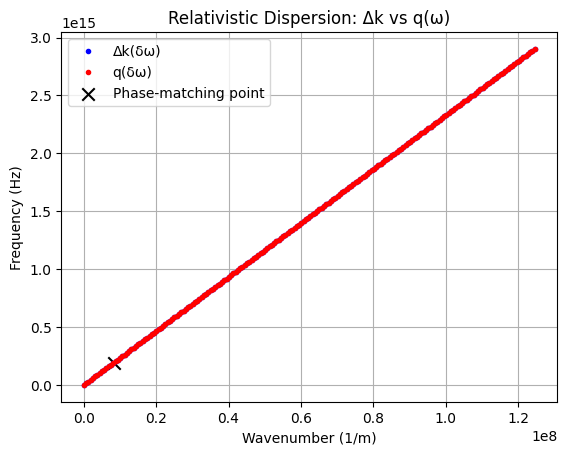

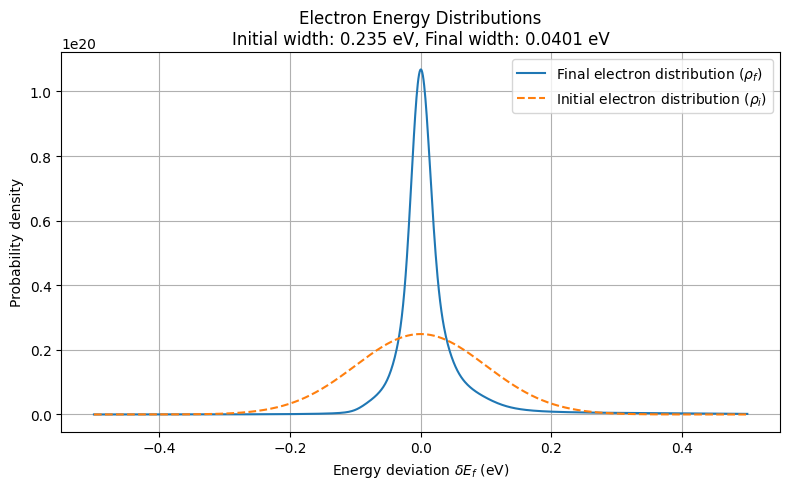

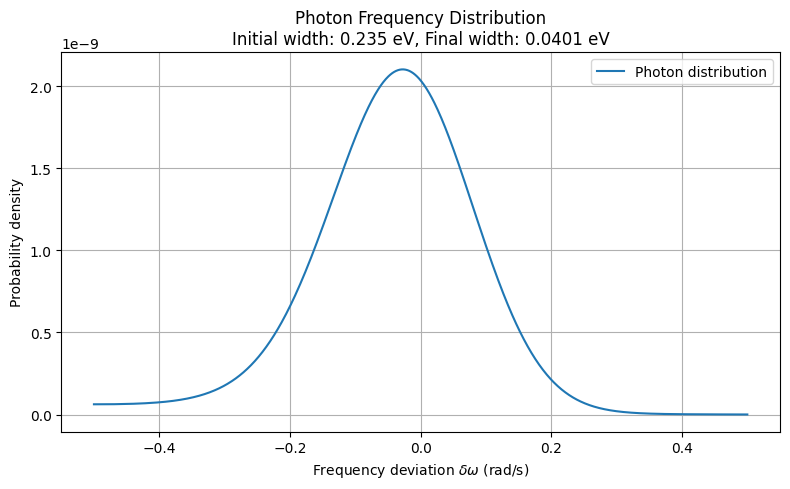

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:06<00:00, 84.16it/s]


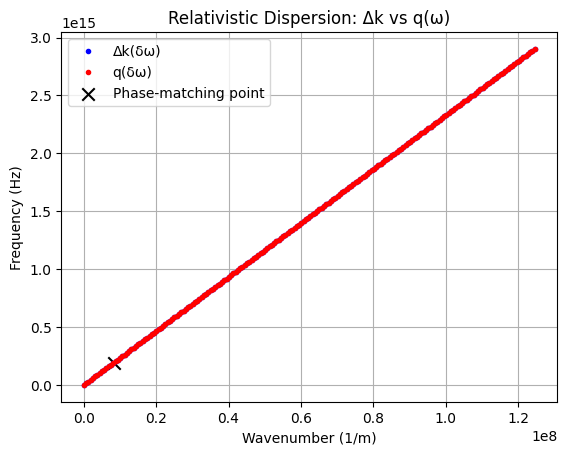

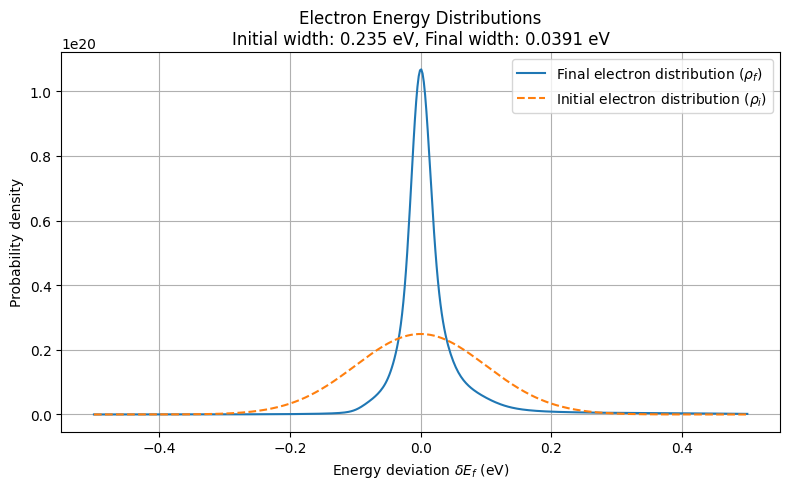

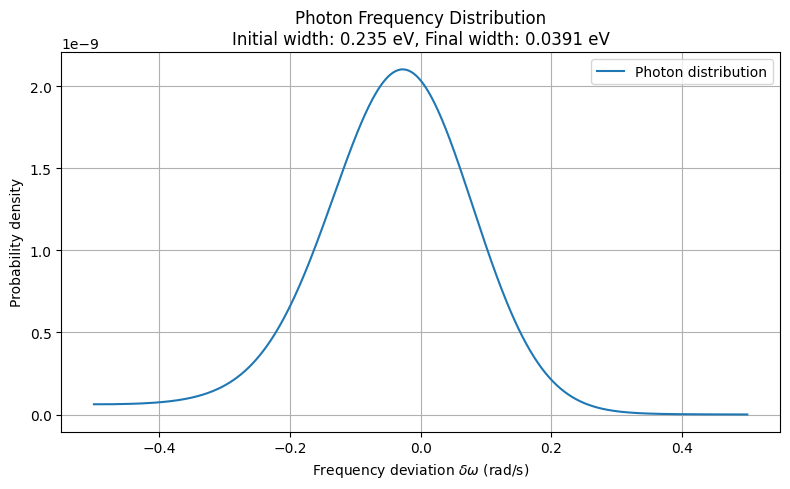

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:05<00:00, 93.57it/s] 


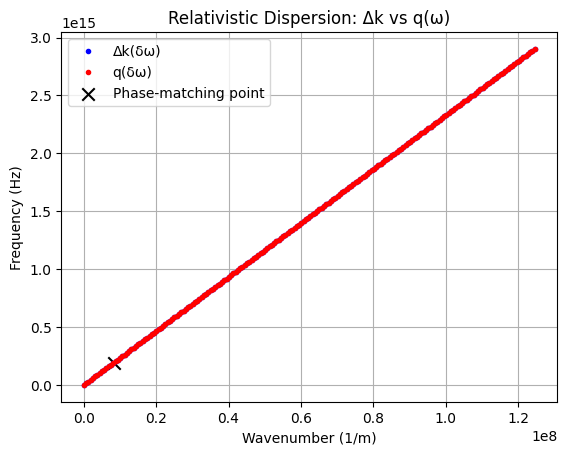

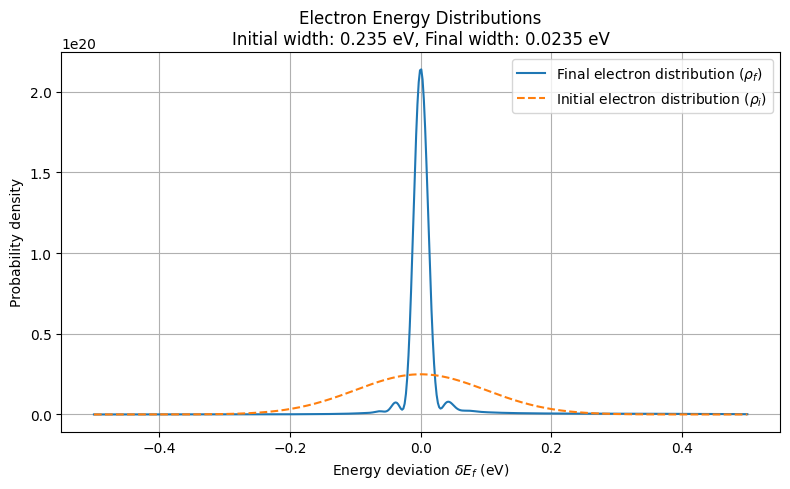

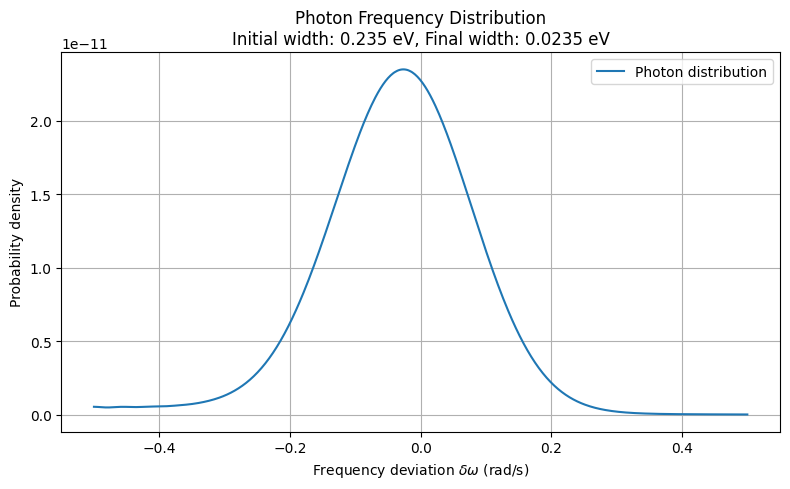

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:06<00:00, 75.72it/s]


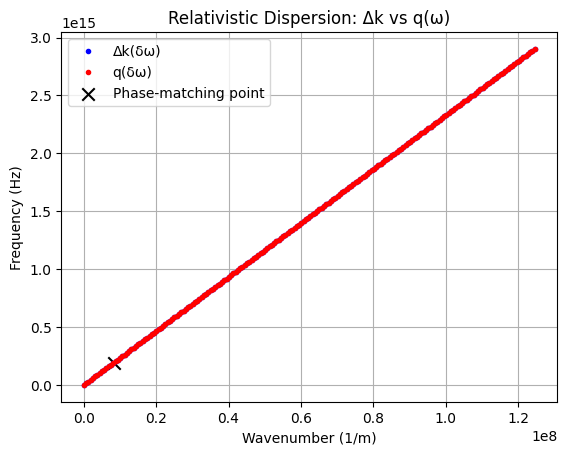

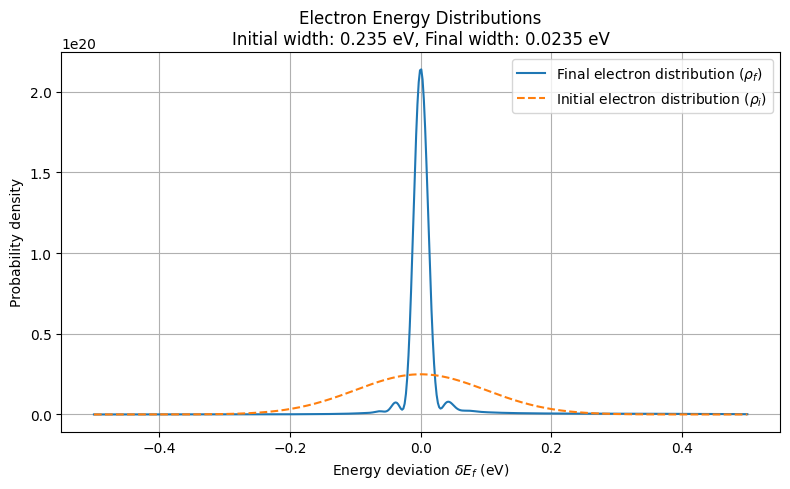

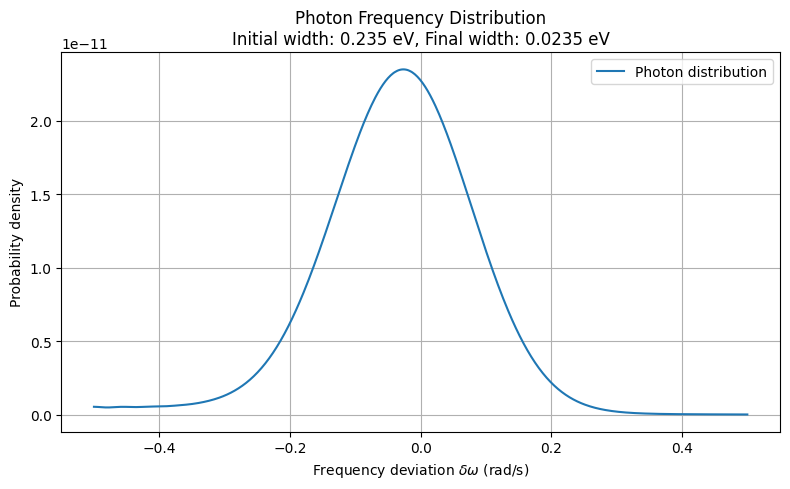

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 300

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:06<00:00, 73.45it/s]


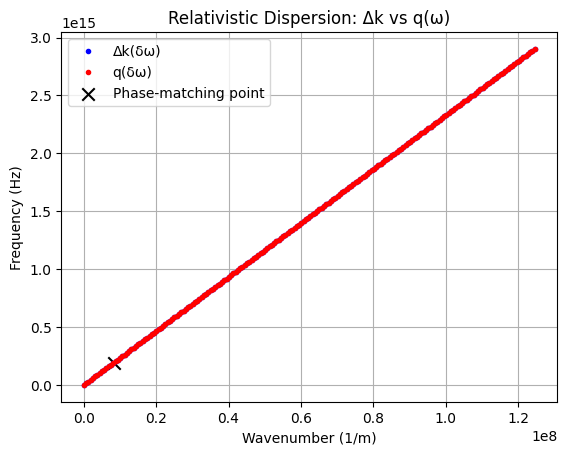

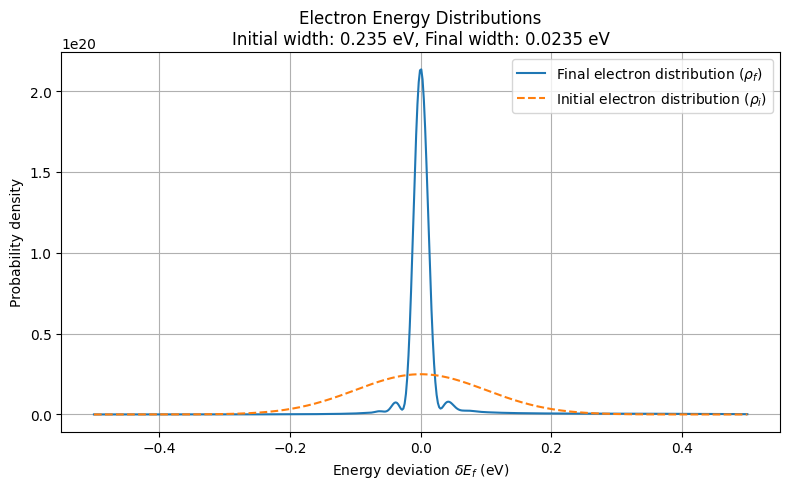

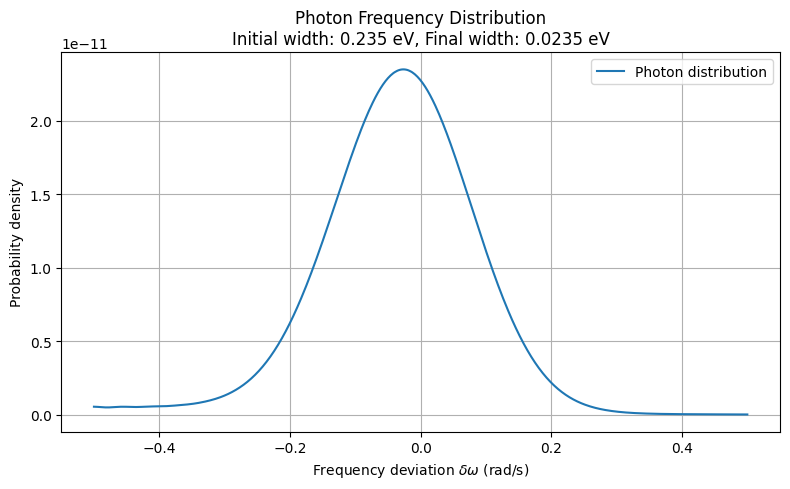

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:07<00:00, 68.02it/s]


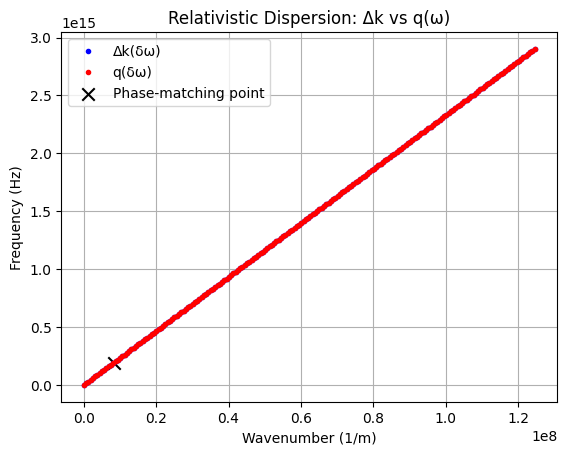

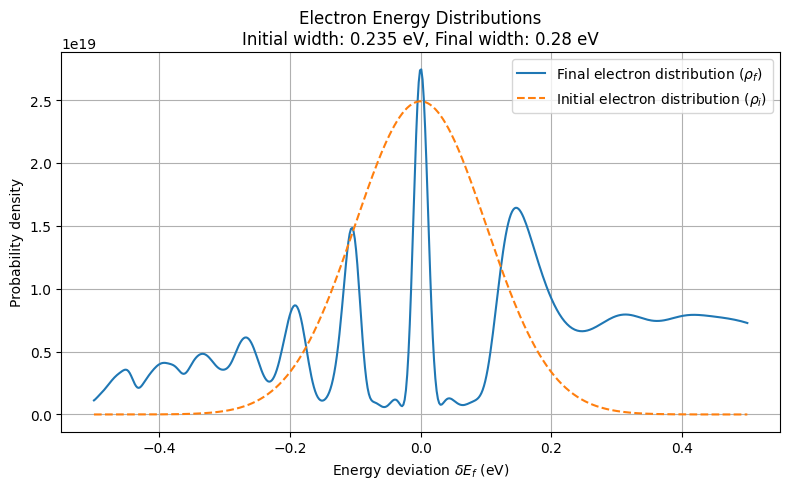

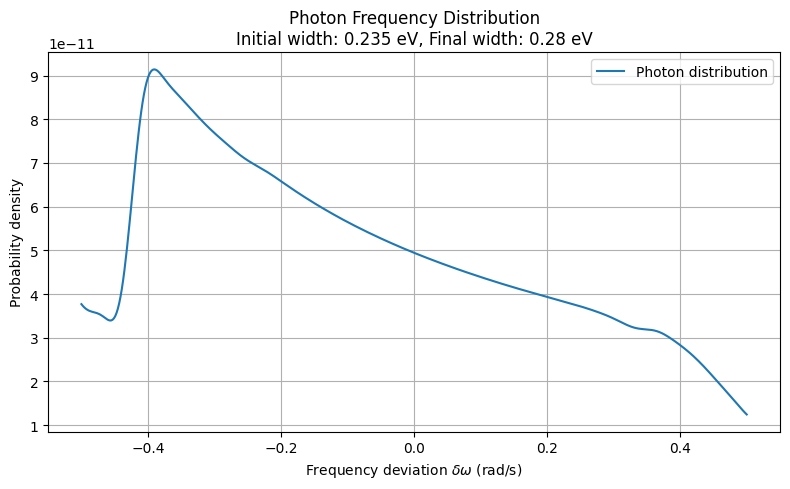

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:22<00:00, 45.53it/s]


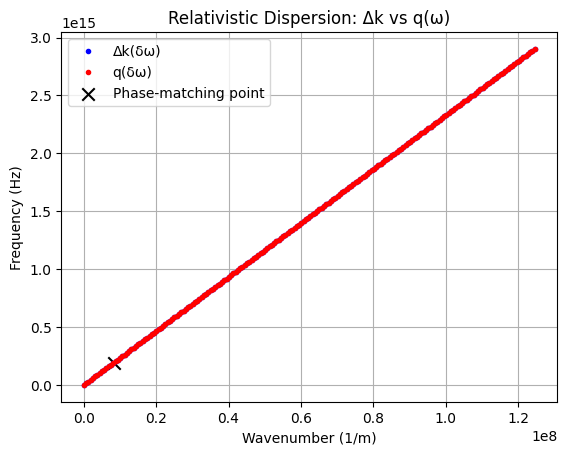

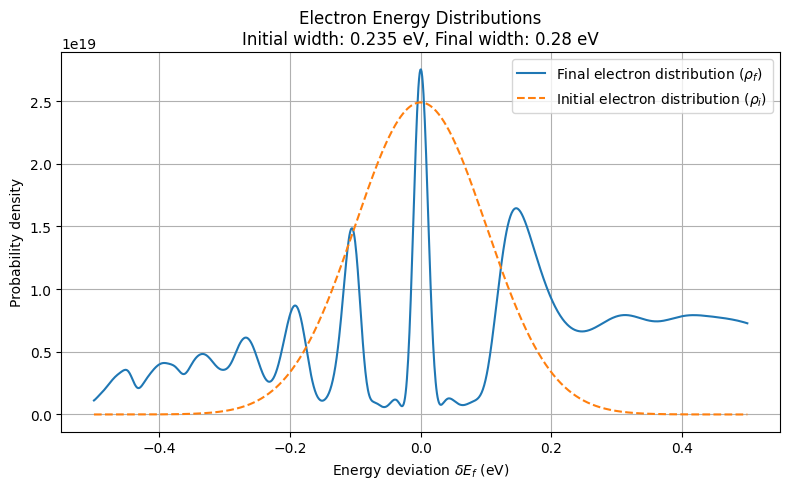

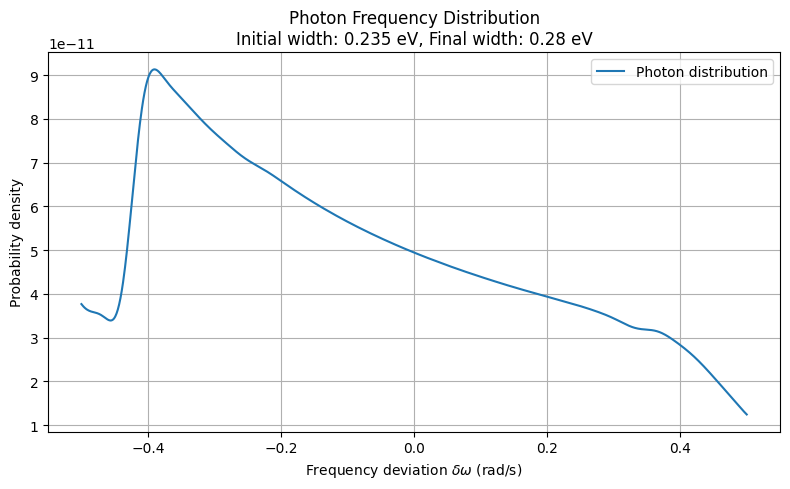

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:23<00:00, 44.07it/s]


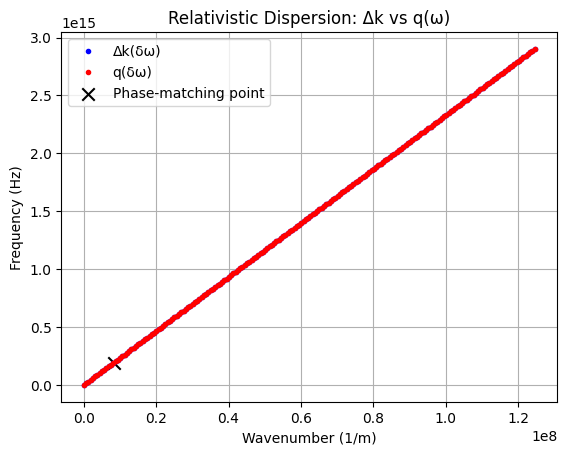

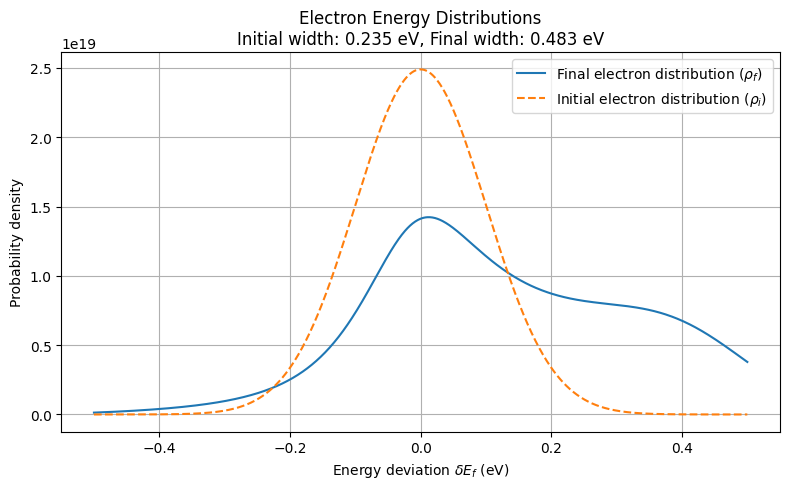

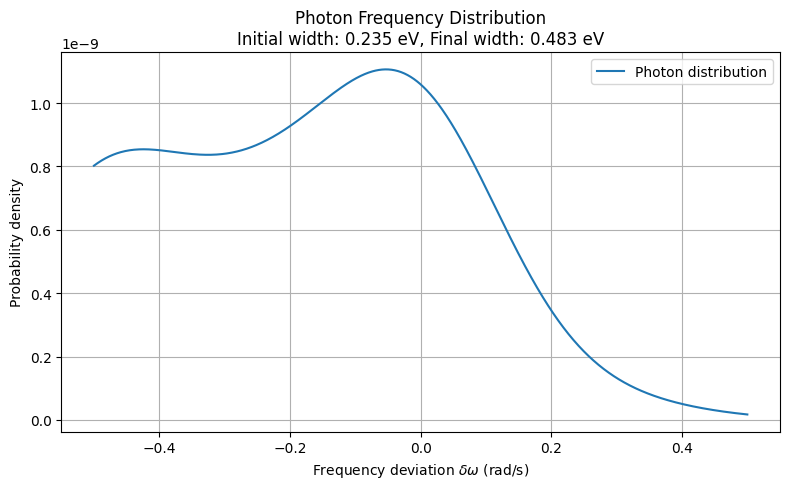

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ω + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:24<00:00, 42.28it/s]


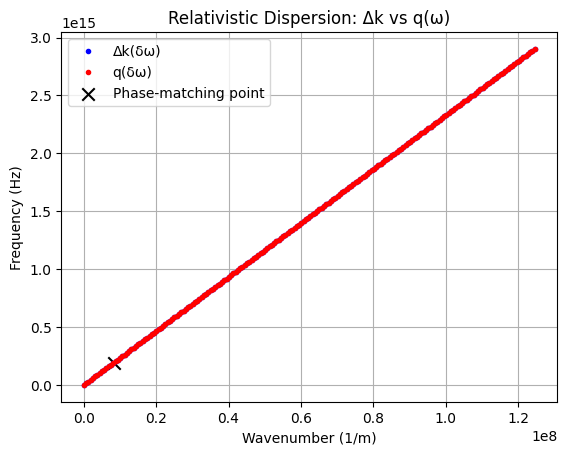

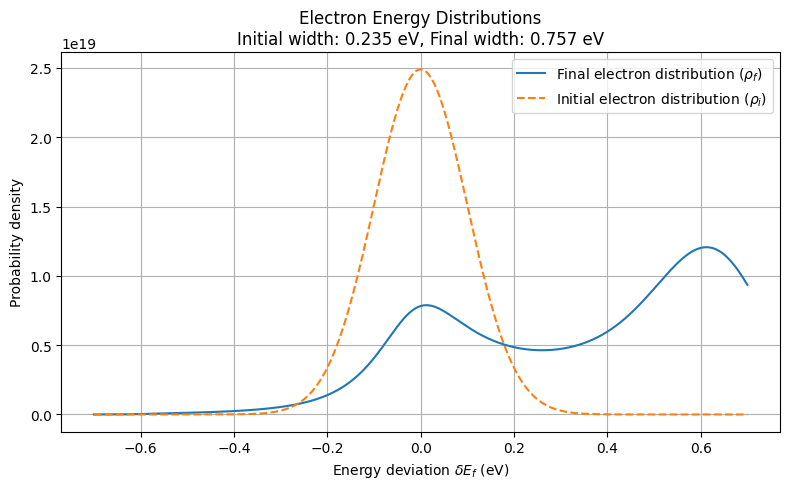

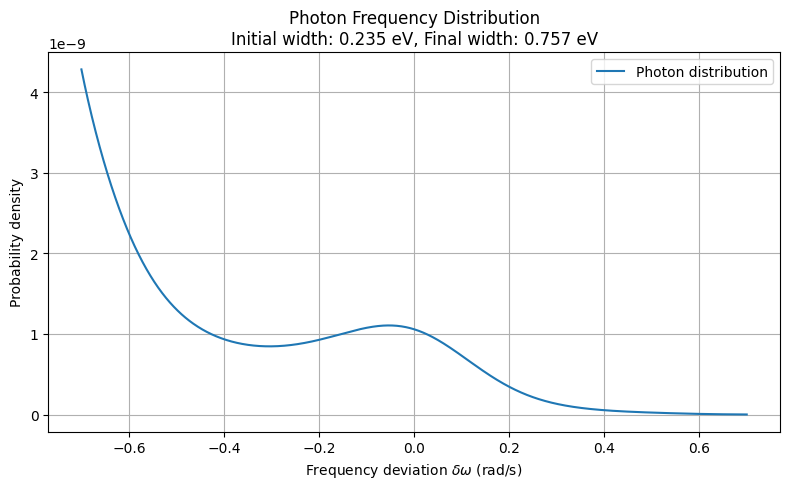

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:05<00:00, 87.83it/s]


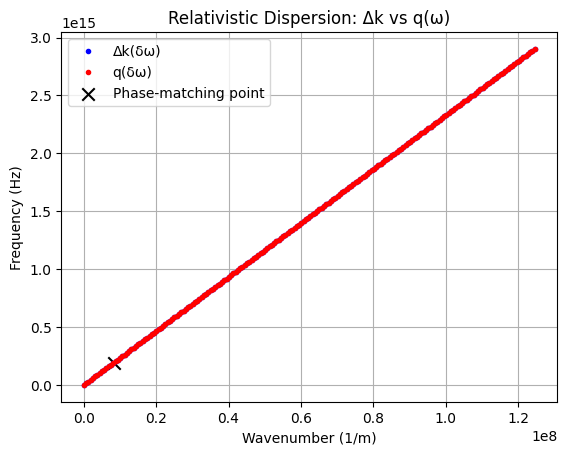

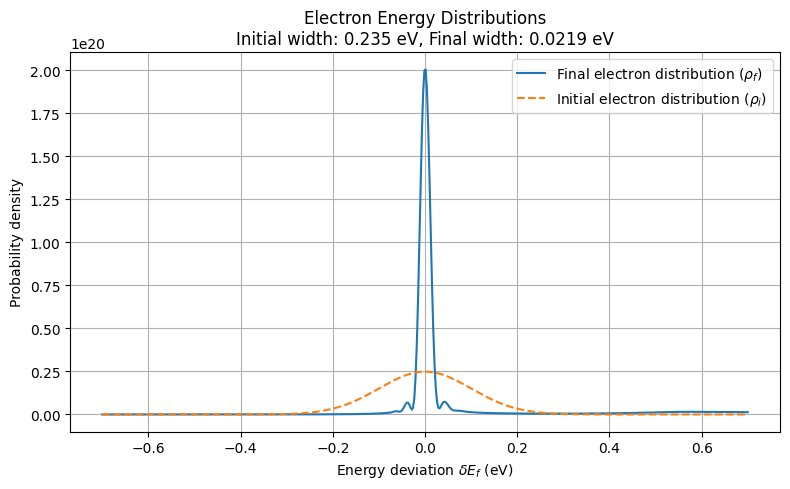

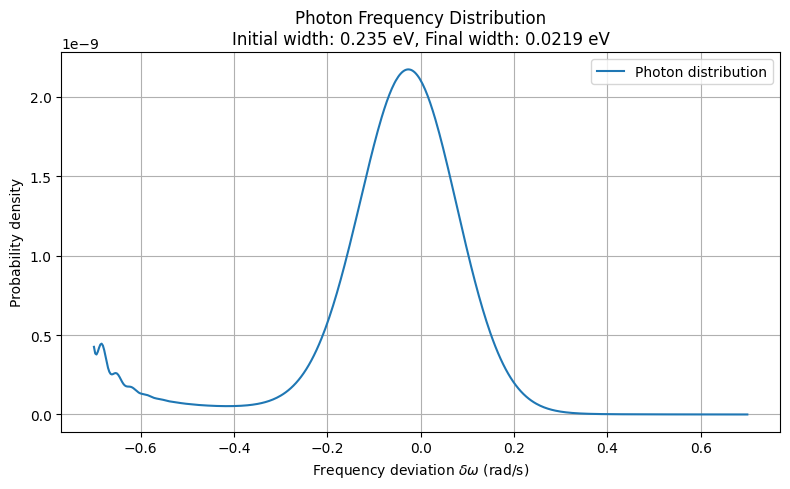

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**11
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 2048/2048 [01:25<00:00, 24.00it/s]


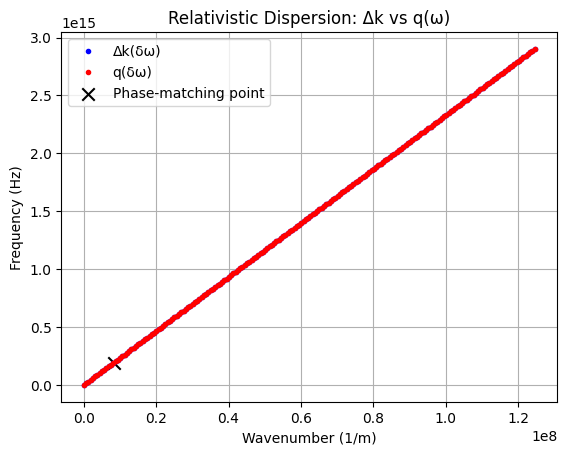

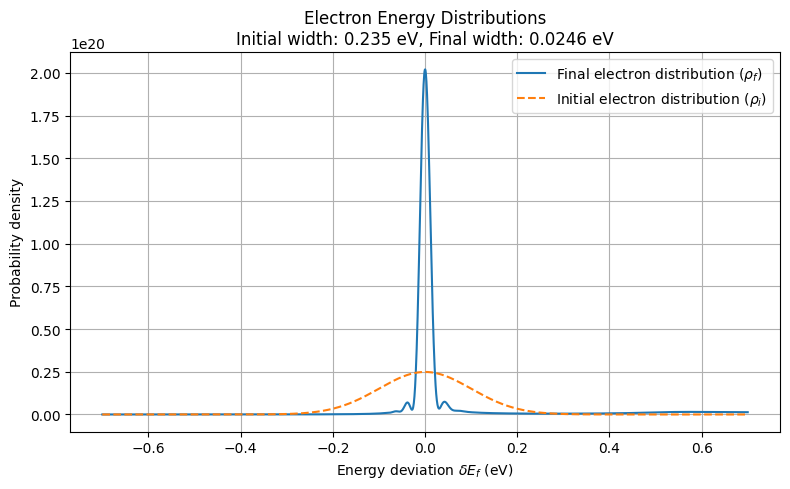

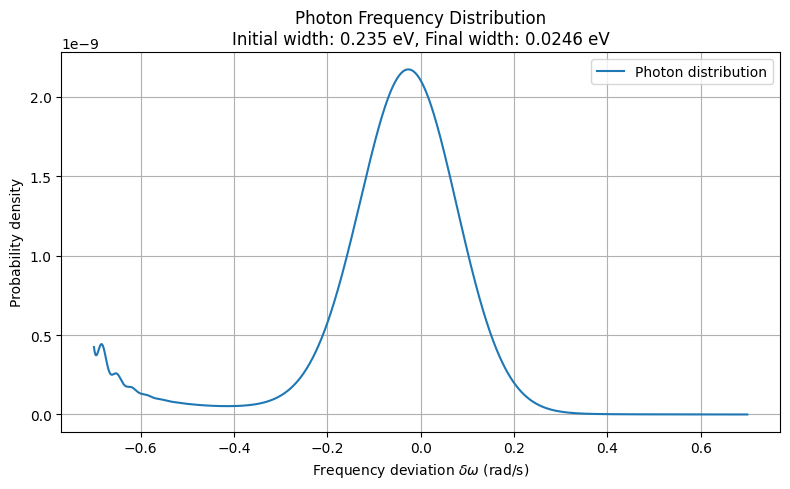

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ω + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:12<00:00, 81.23it/s] 


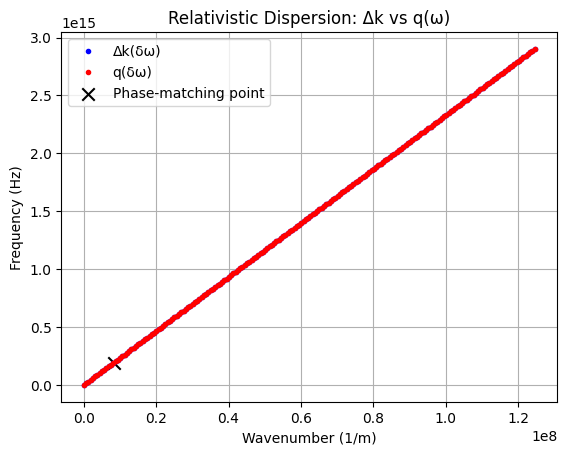

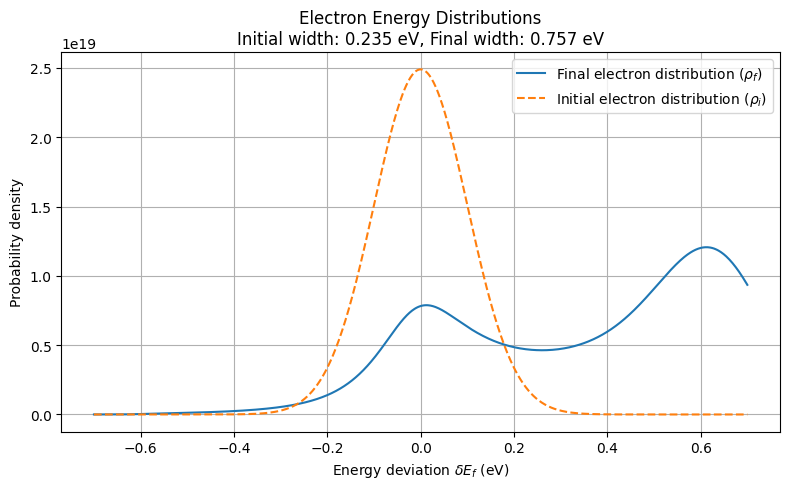

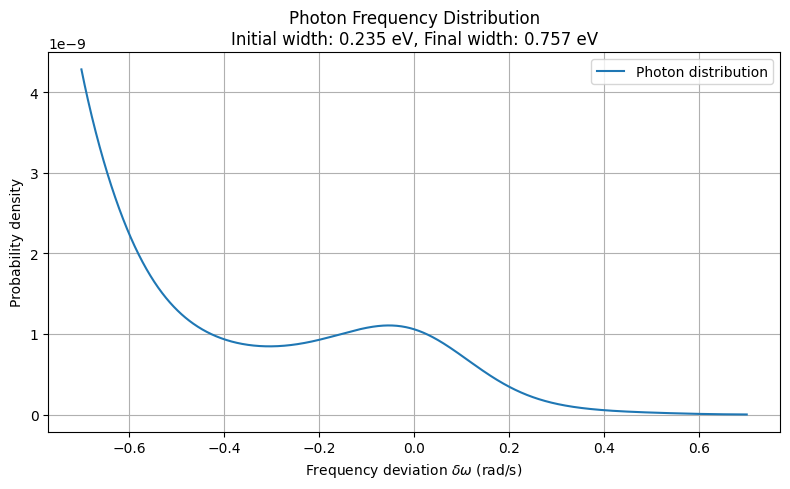

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:13<00:00, 77.27it/s] 


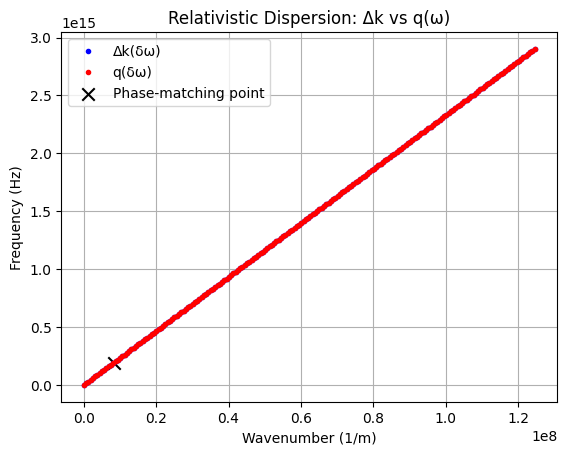

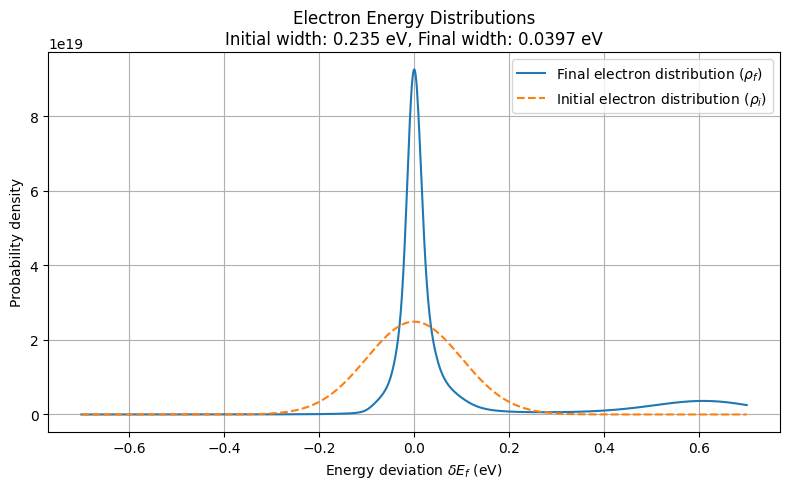

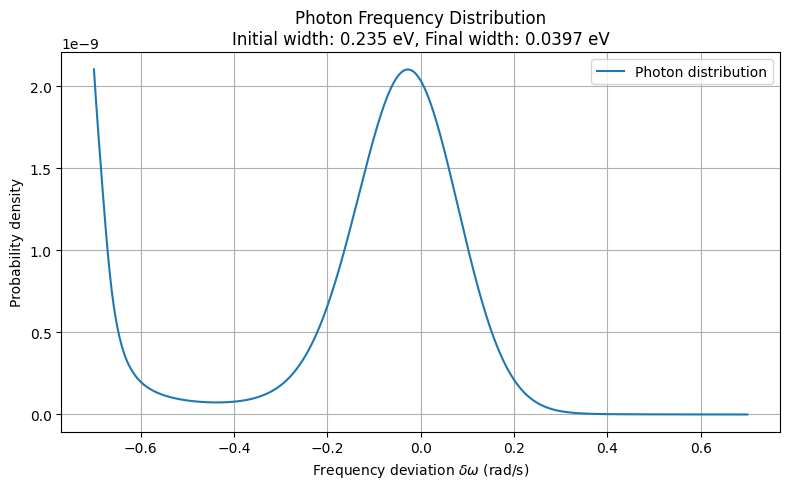

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ω + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:23<00:00, 43.97it/s]


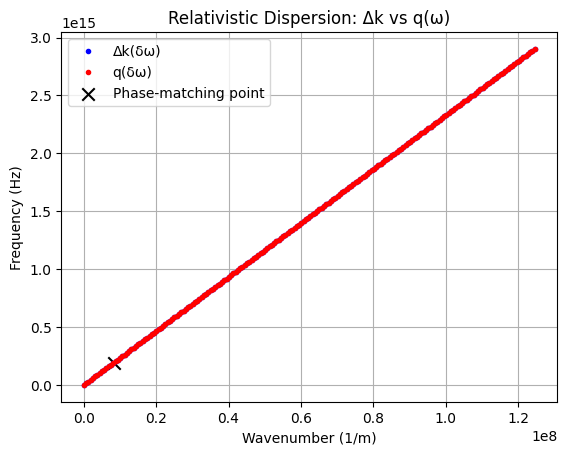

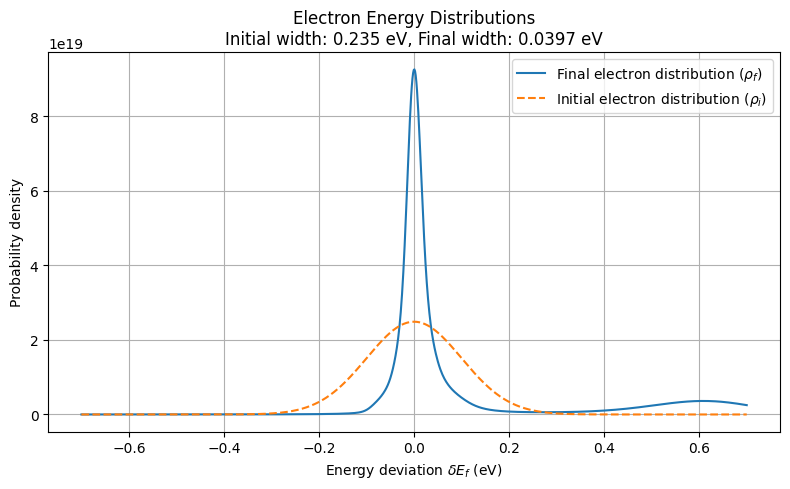

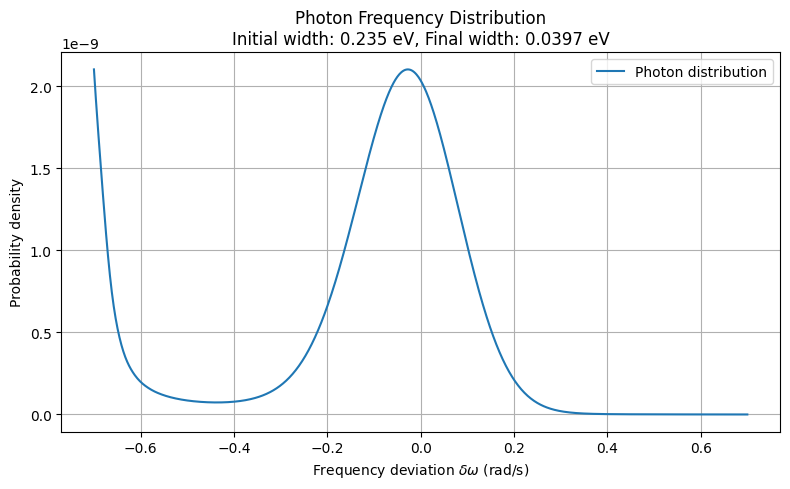

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**11
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 2048/2048 [01:24<00:00, 24.11it/s]


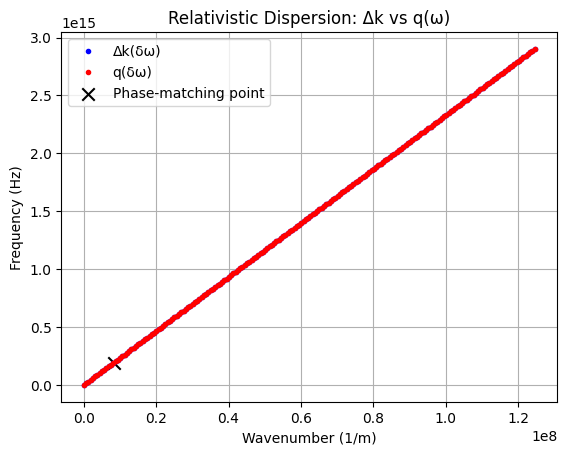

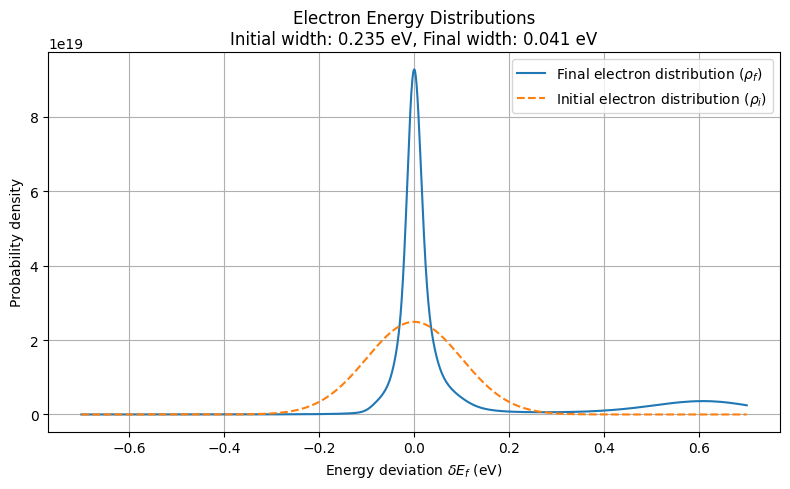

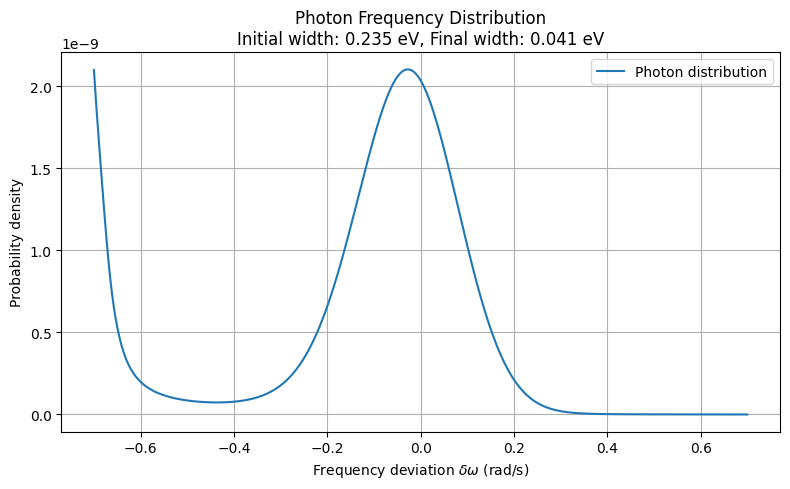

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
k_rel(E0 + δE_col + hbar * ω)

NameError: name 'δE_col' is not defined

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ωp) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ωp[:, None])
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ωp[:, None]) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ωp) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ωp[:, None])
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ωp[:, None]) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω:   0%|          | 0/1024 [00:00<?, ?it/s]


ValueError: operands could not be broadcast together with shapes (1,1024) (513,) 

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 64.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ωp[:, None]) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ωp[:, None])
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ωp[:, None]) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0.1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:58<00:00, 17.43it/s]


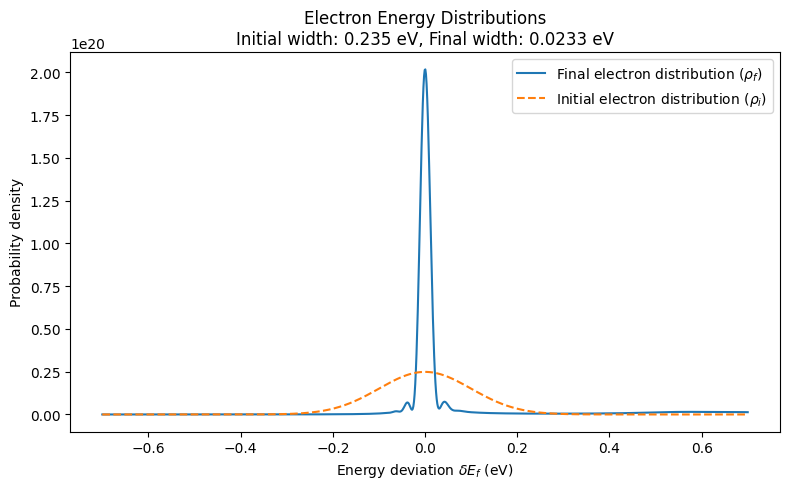

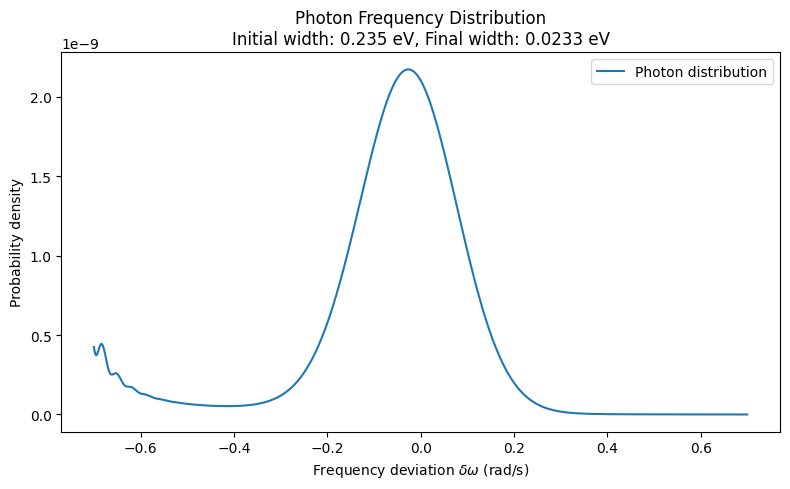

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

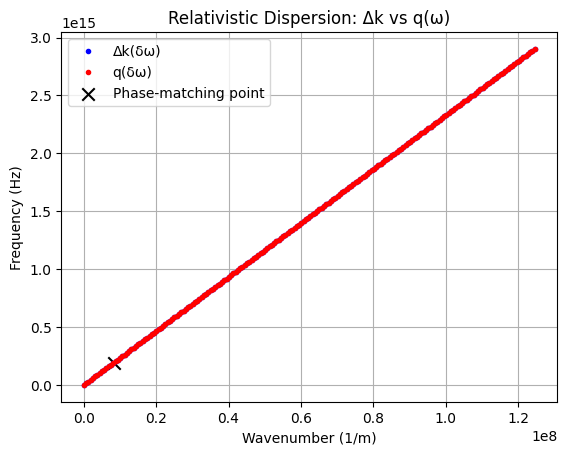

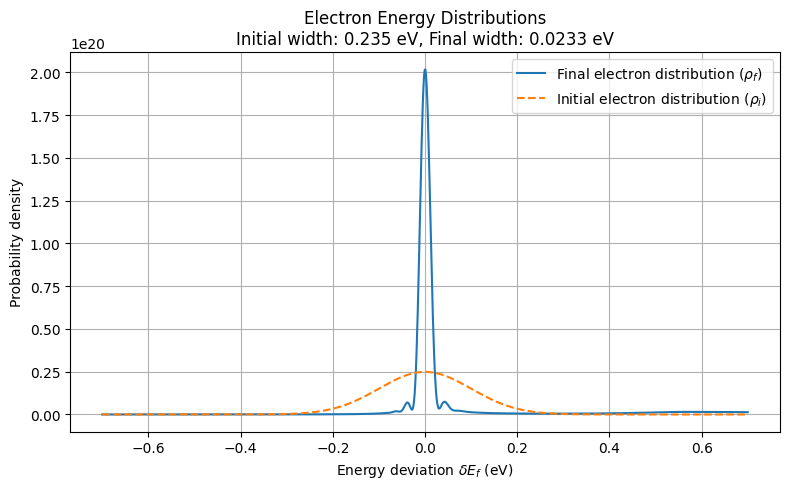

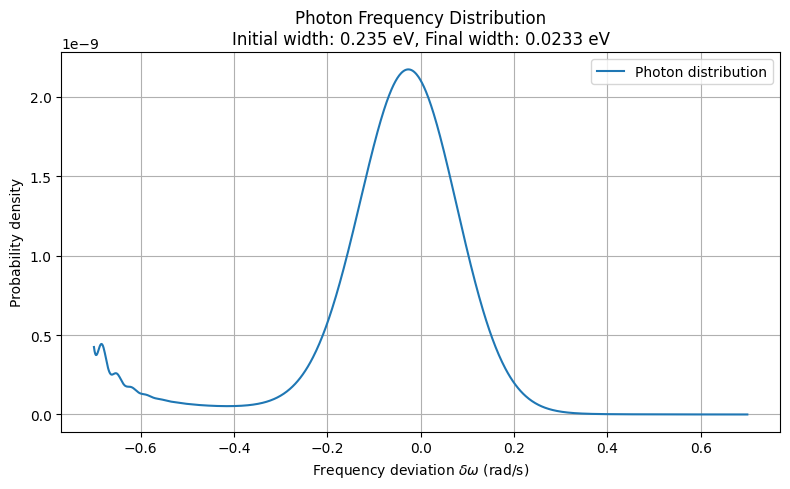

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:56<00:00, 18.14it/s]


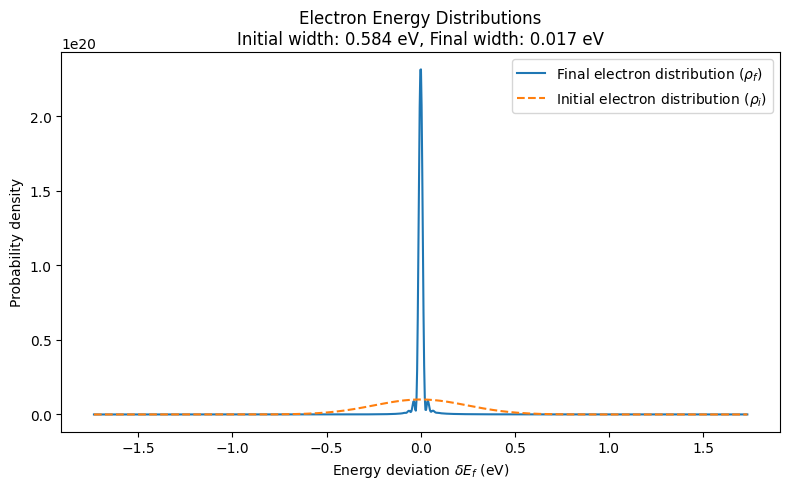

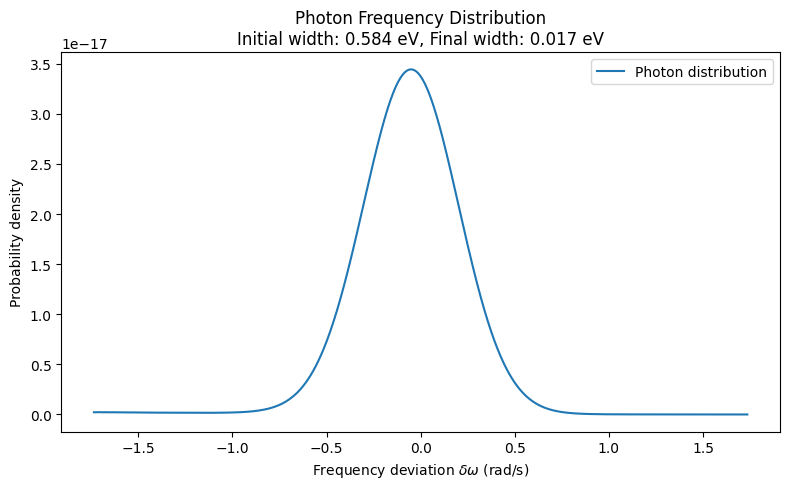

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:56<00:00, 18.26it/s]


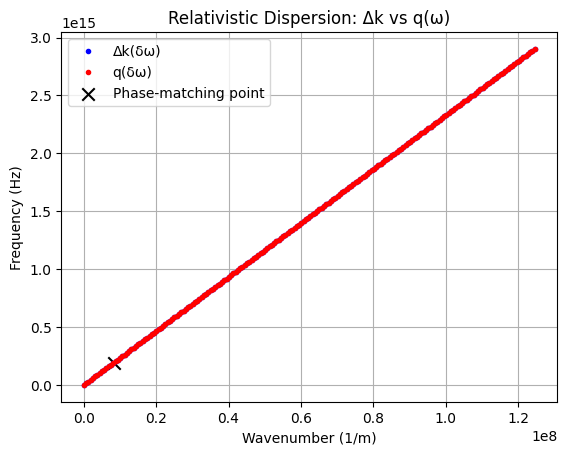

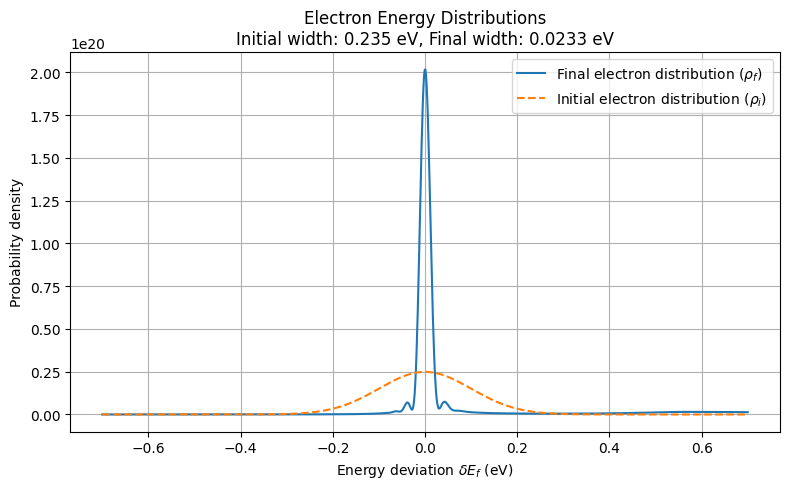

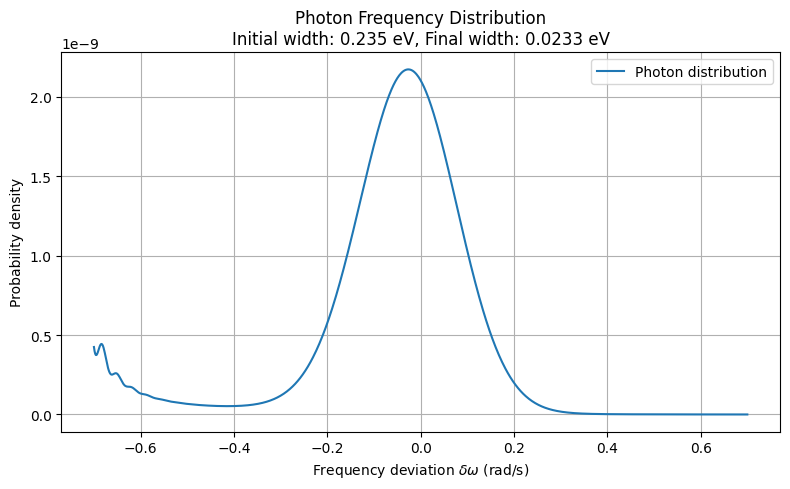

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 7
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ωp[:, None]) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ωp[:, None])
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ωp[:, None]) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**11
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 10

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 2048/2048 [01:55<00:00, 17.69it/s]


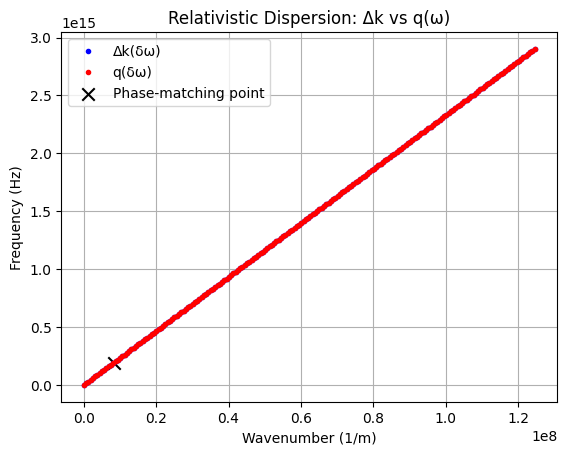

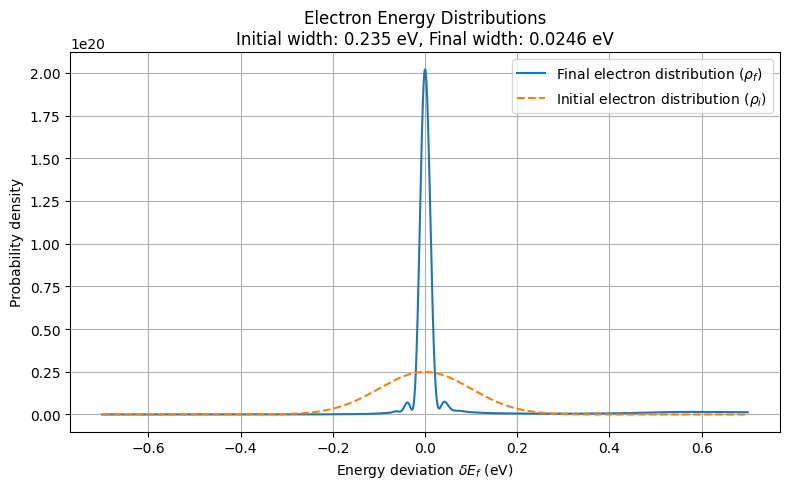

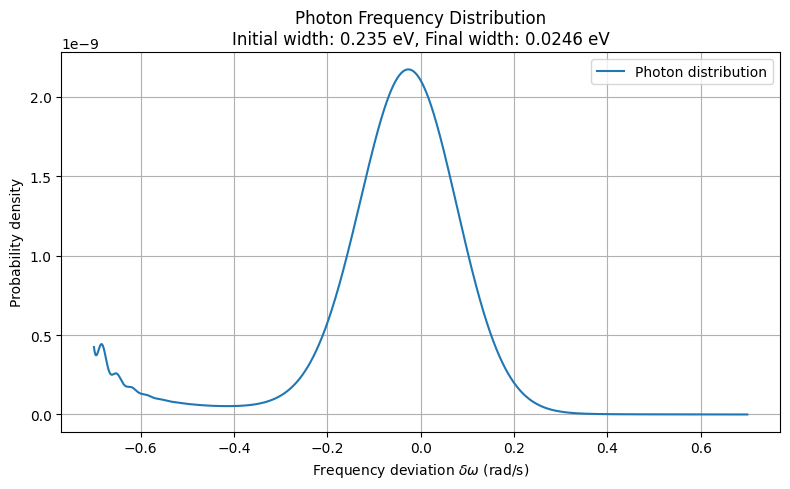

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ωp[:, None]) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ωp[:, None])
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None] ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ωp[:, None]) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**12
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 10

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 4096/4096 [07:50<00:00,  8.71it/s]


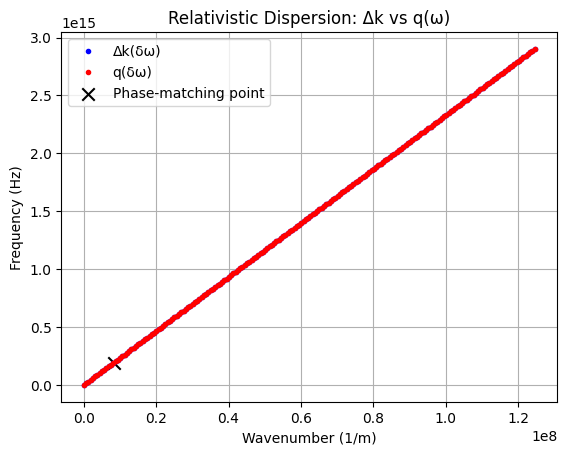

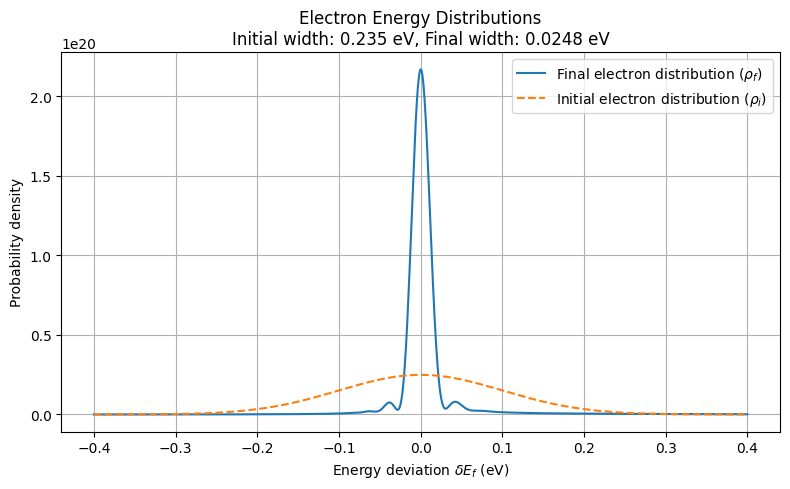

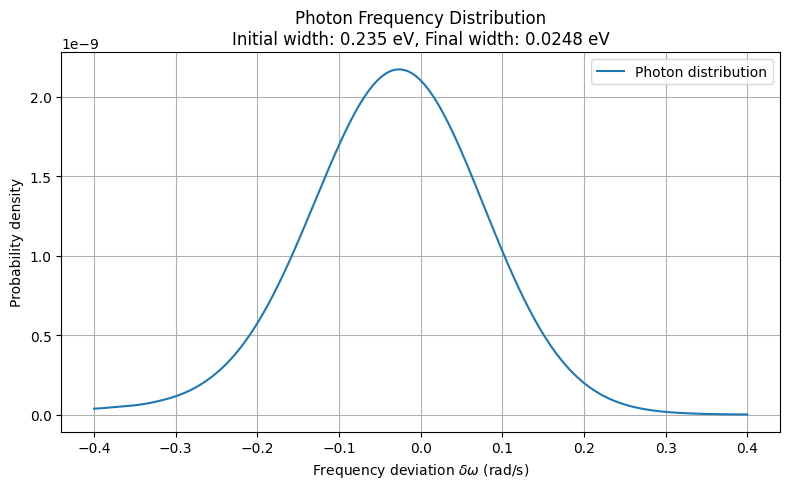

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
E0

np.float64(1.1945893963335149e-14)

In [ ]:
v0

np.float64(146392819.0515279)

In [ ]:
v0

np.float64(146392819.0515279)

In [ ]:
146392819.0515279/c

0.48831388230429695

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 10

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:07<00:00, 65.17it/s]


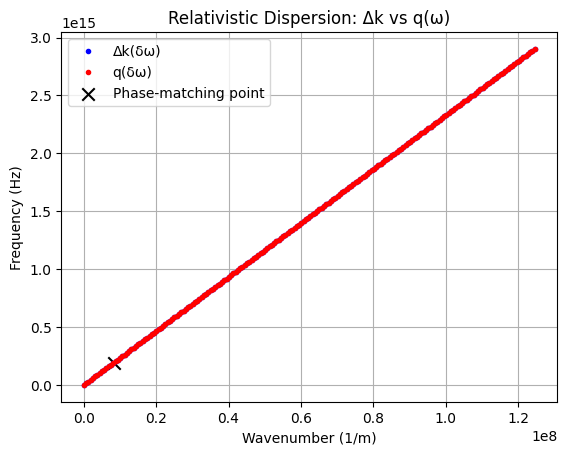

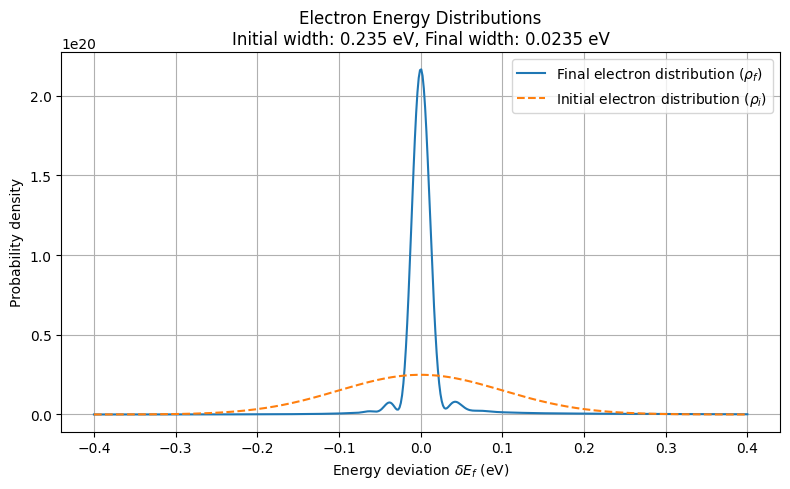

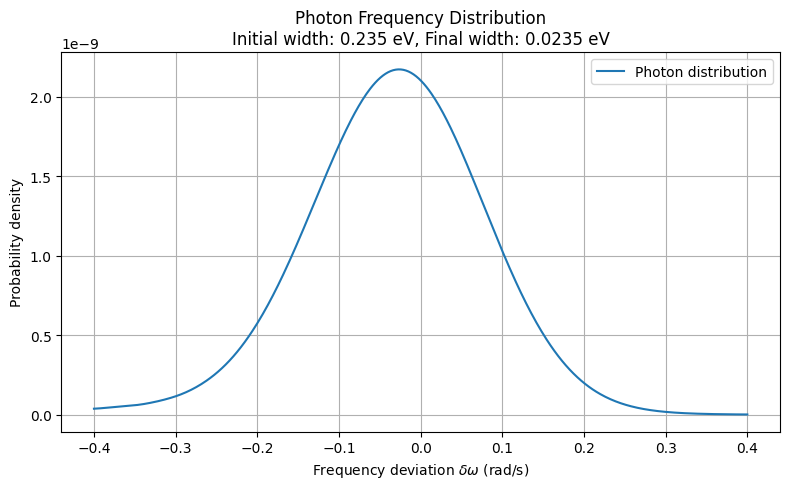

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
L_int

5

In [ ]:
sigmaE

0.1

In [ ]:
v0

np.float64(146392819.0515279)

In [ ]:
146392819.0515279/c

0.48831388230429695

In [ ]:
sigmaE

0.1

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 10

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:08<00:00, 59.91it/s]


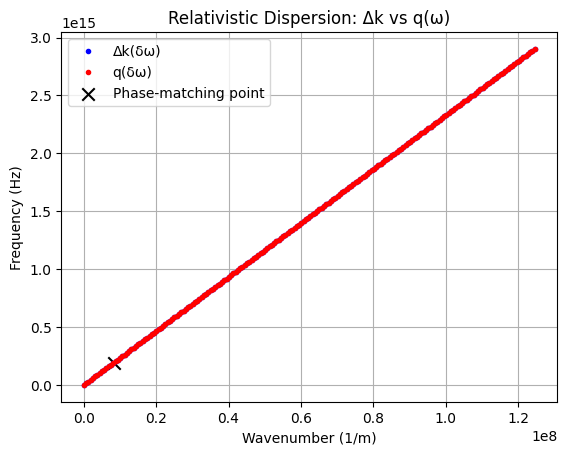

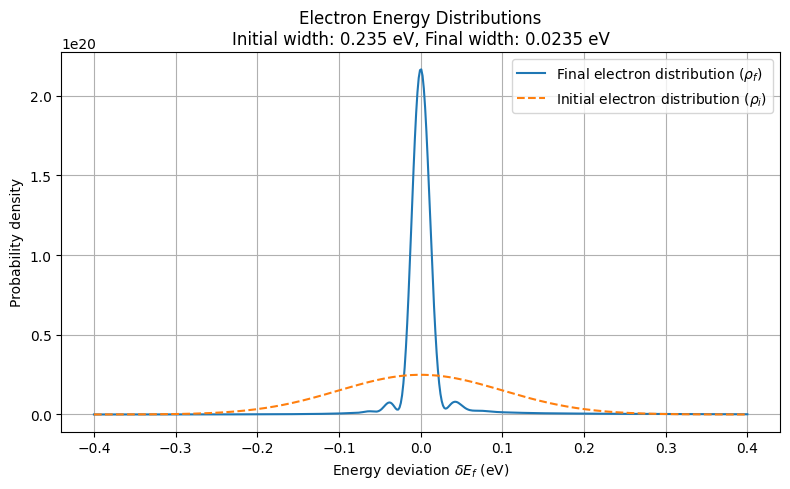

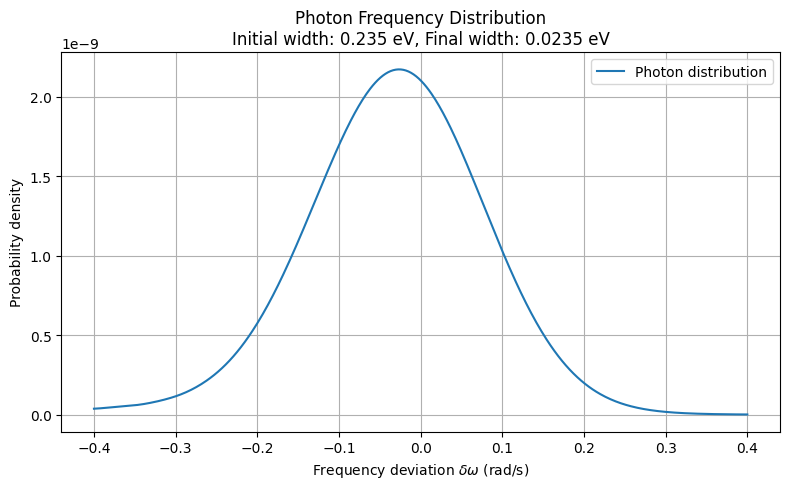

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:07<00:00, 65.10it/s]


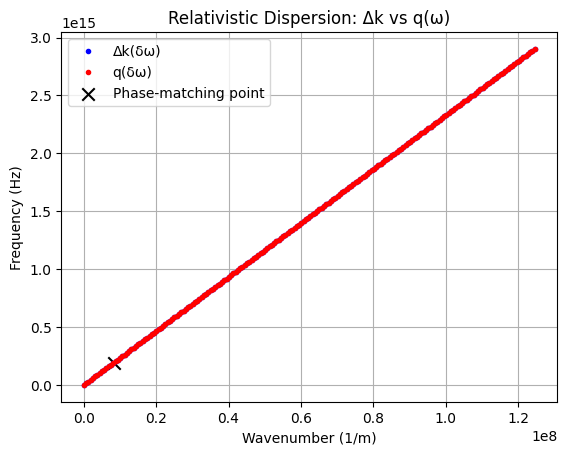

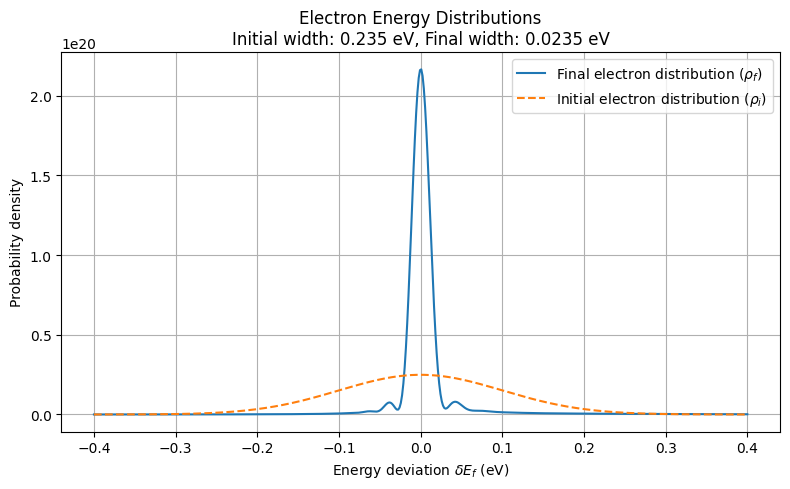

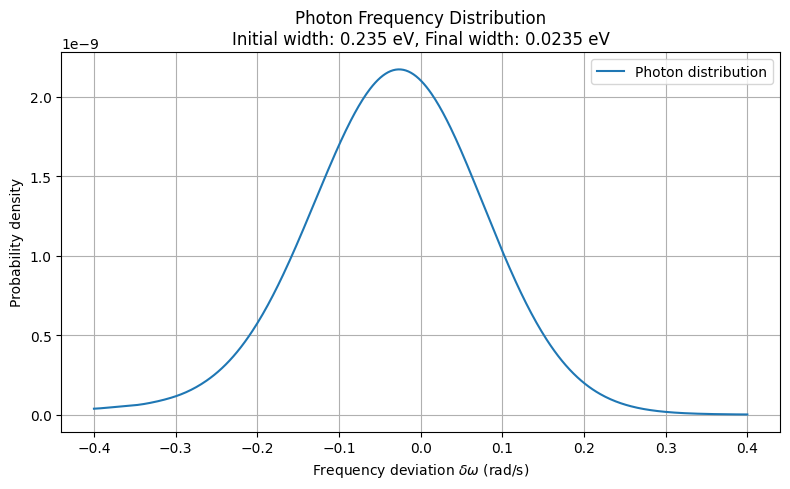

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N =2**9
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:08<00:00, 63.10it/s]


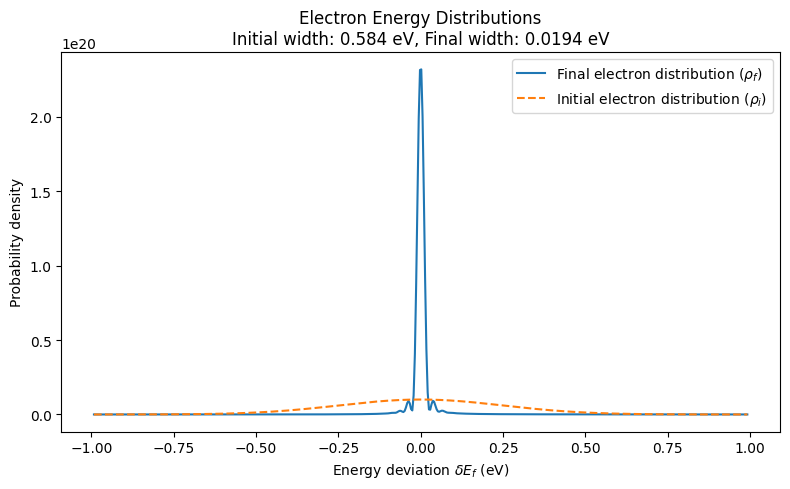

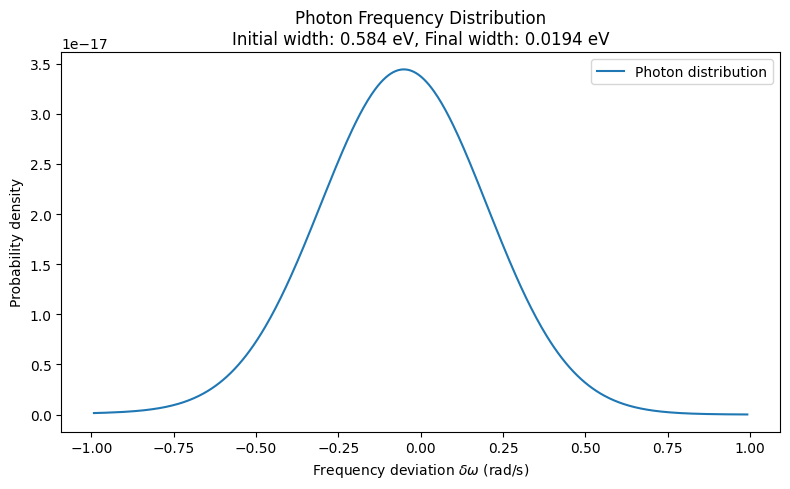

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
N =2**9
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:07<00:00, 66.21it/s]


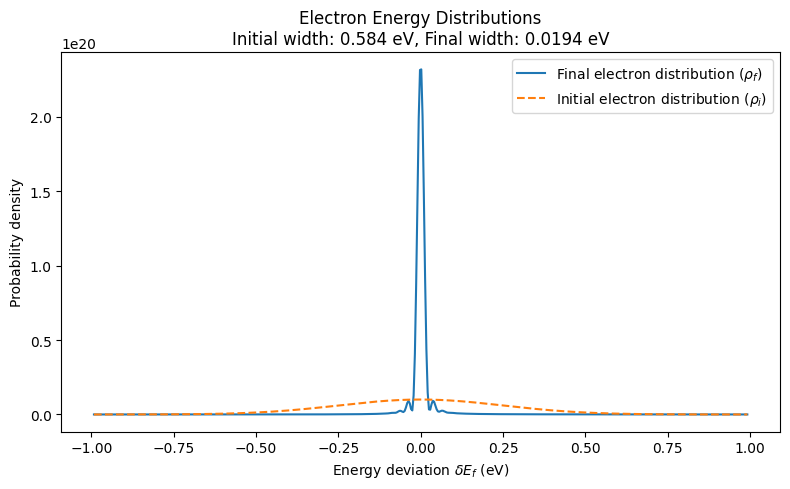

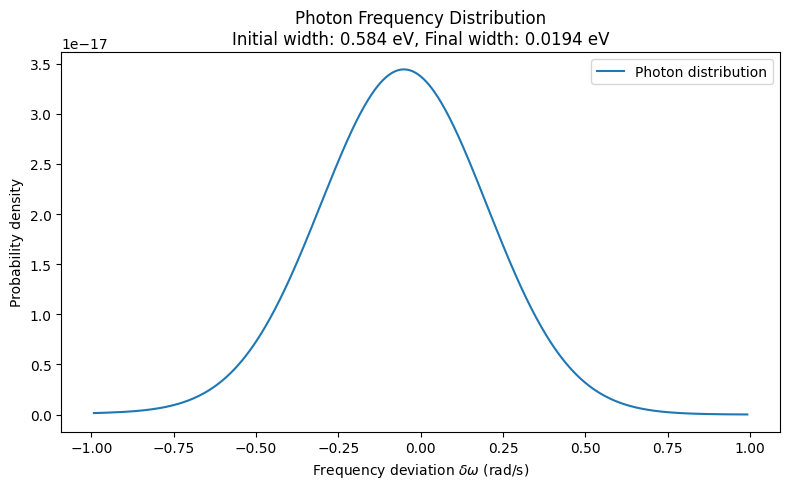

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:28<00:00, 35.65it/s]


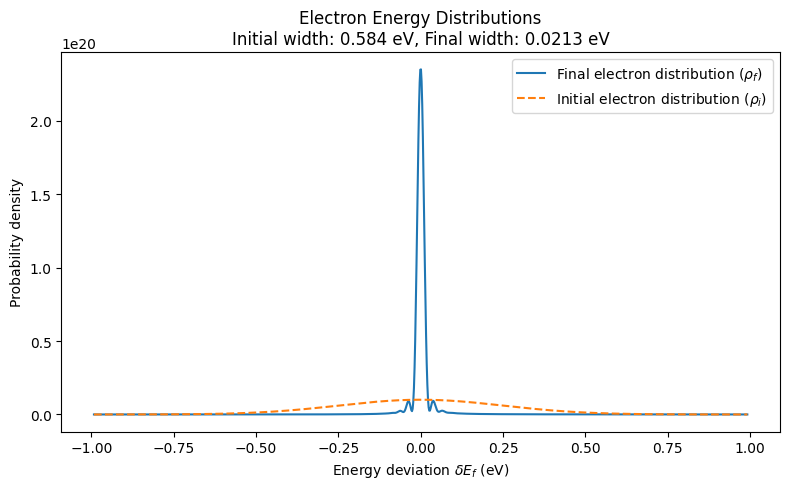

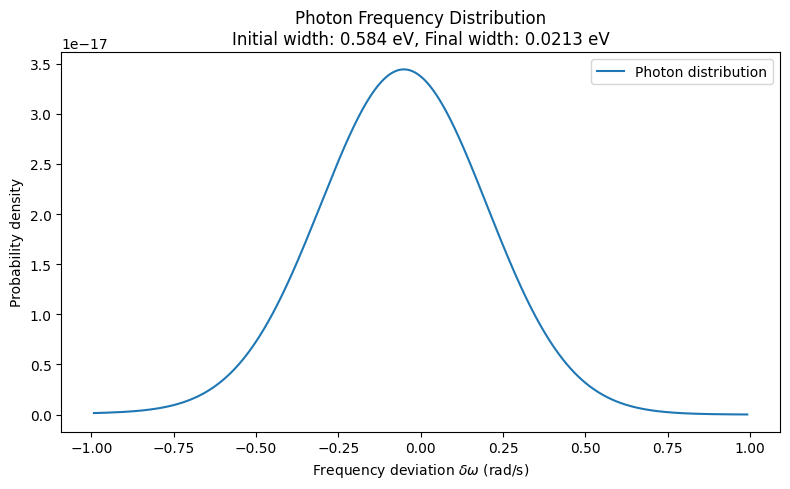

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ω / v_g) + 0.5 * recoil * (ω ** 2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:02<00:00, 368.80it/s]


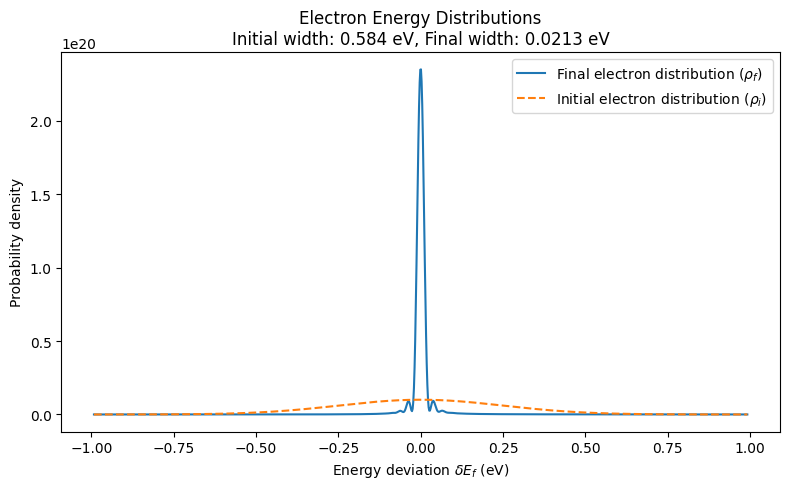

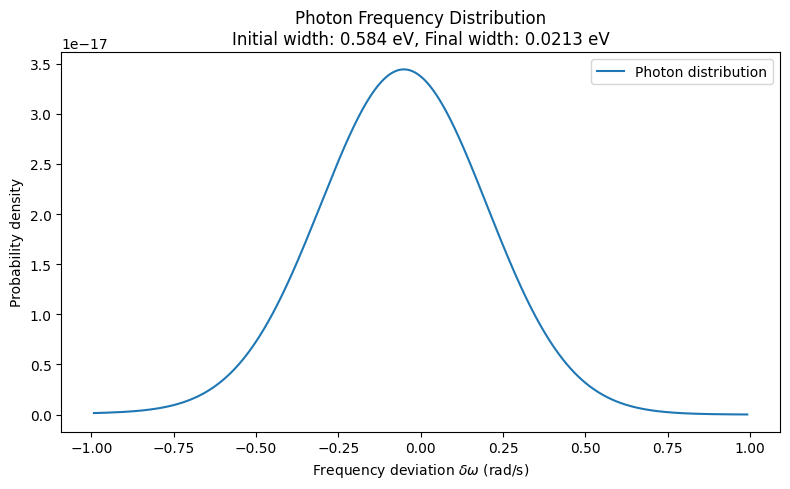

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:02<00:00, 365.15it/s]


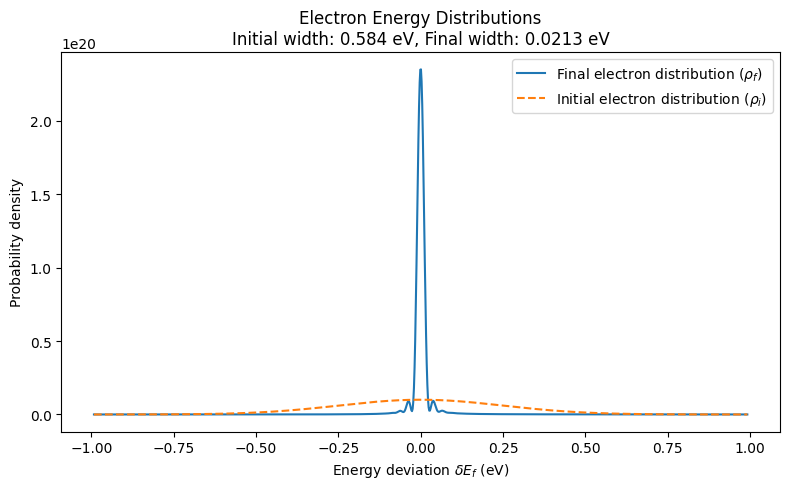

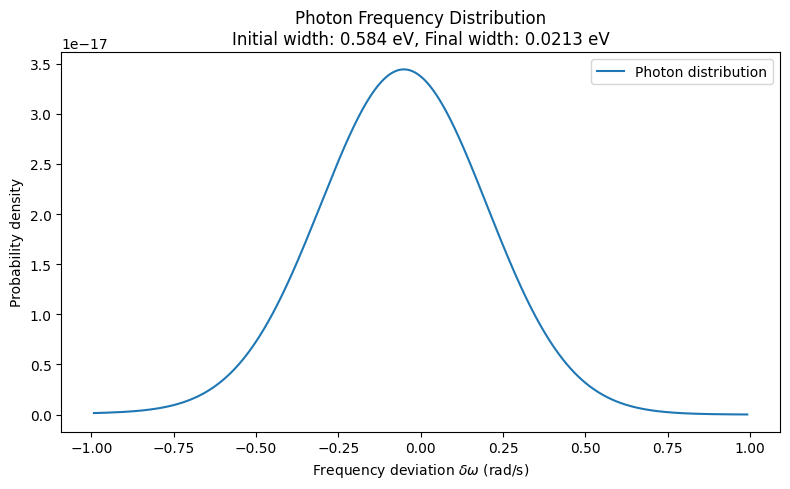

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:11<00:00, 86.50it/s]


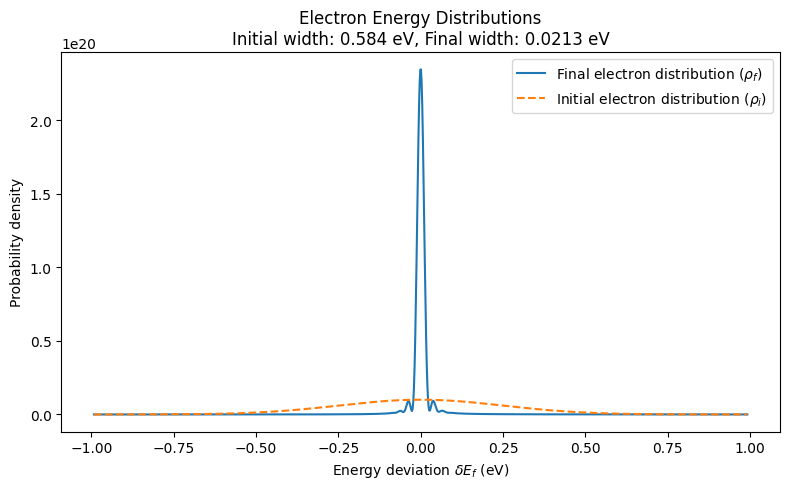

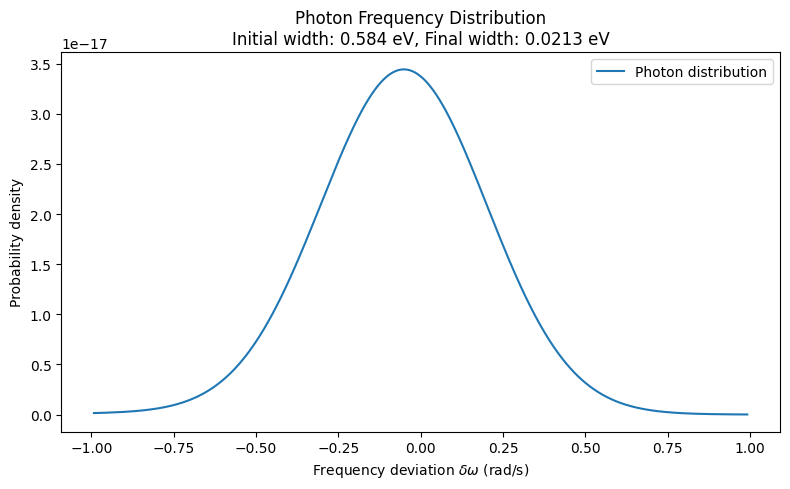

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N =2**10
v0 = 0.1 * c  # electron velocity
E0 = E_rel(v0)
lambda0 = 500e-9
omega0 = 2 * np.pi * c / lambda0  # central angular frequency (rad/s)
L_int = 0.01  # m
sigmaE = 0.1 * hbar * omega0 / e
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,l_eff = final_state_probability_density_loss(N, L_int, sigmaE, v0, omega0,
                                                                   v_g_func(omega0, v0), recoil_func(omega0, v0), gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:11<00:00, 89.69it/s] 


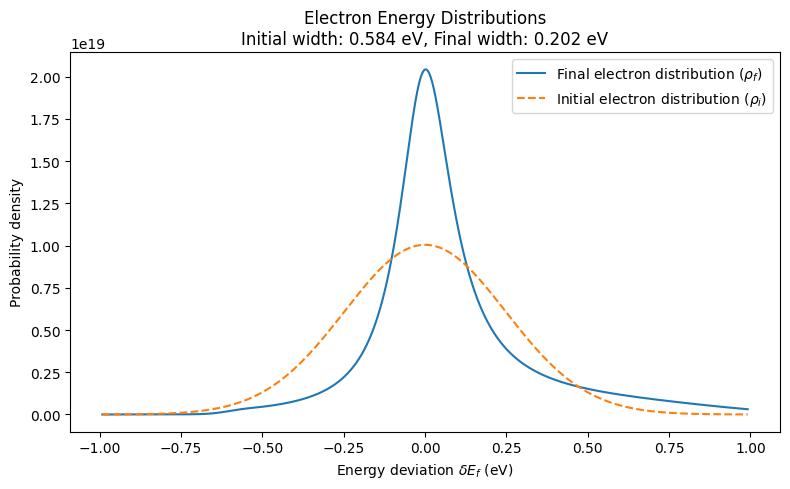

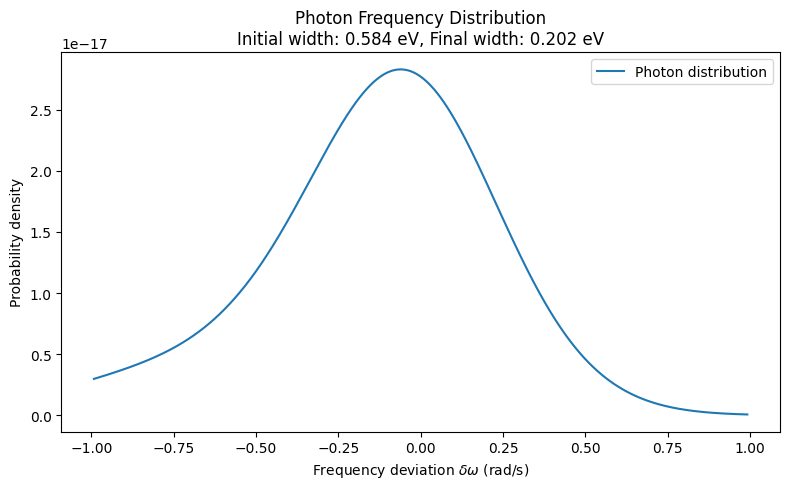

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.tight_layout()
plt.show()

#

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 5  # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 400

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 143.76it/s]


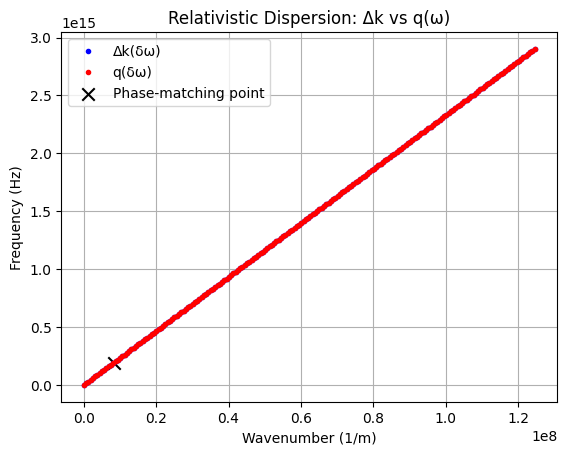

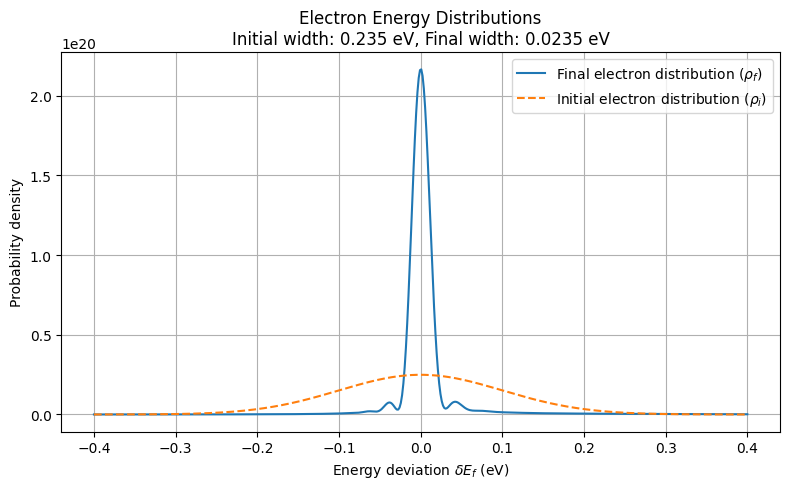

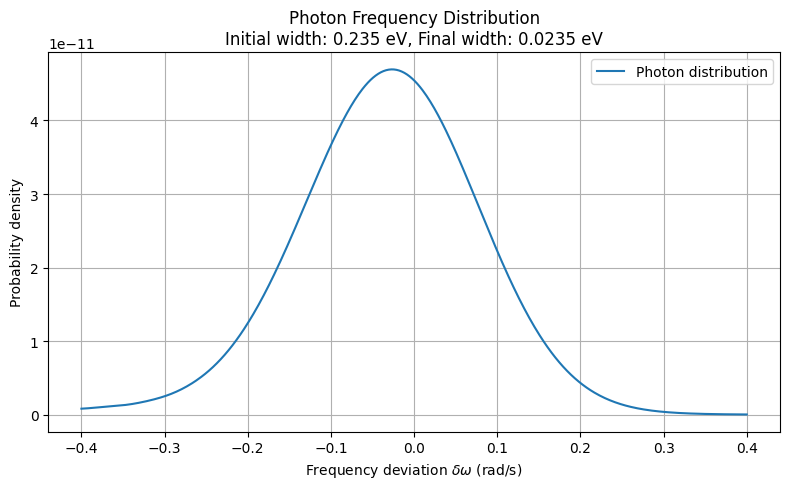

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        U_factor = 1 / 4.1383282083233256e-51

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor * U_factor * rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 4 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:04<00:00, 124.69it/s]


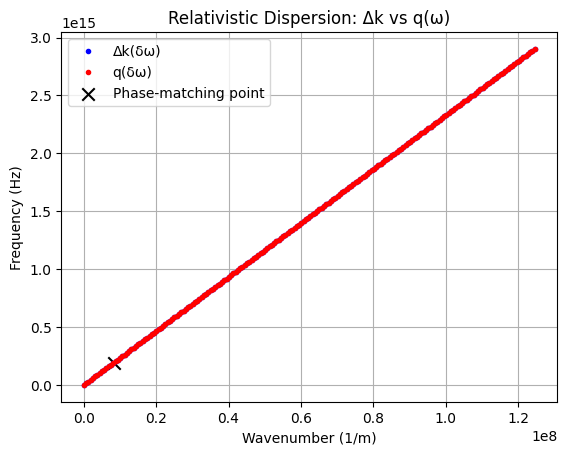

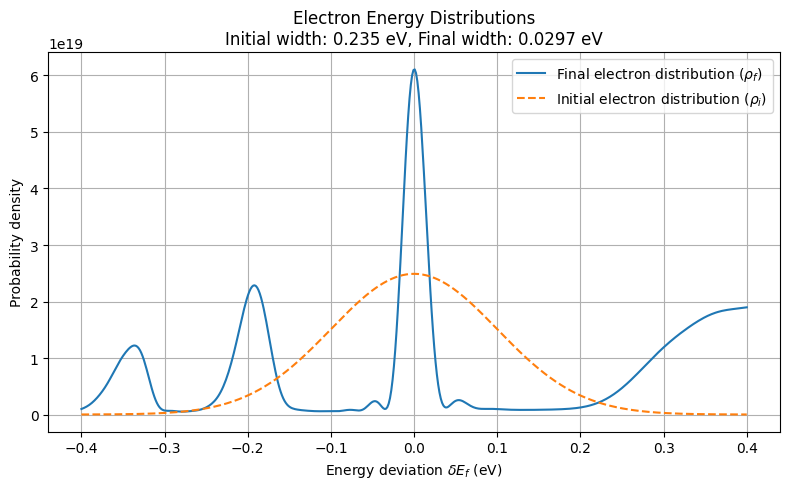

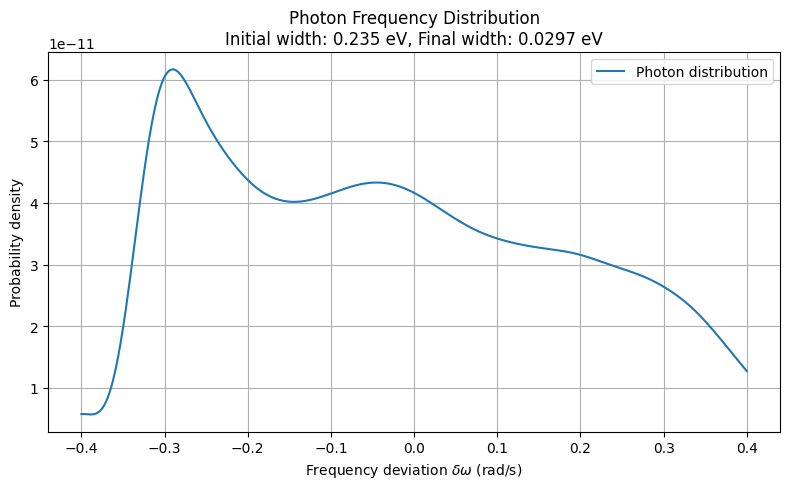

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 4
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor *  rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 4 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 149.09it/s]


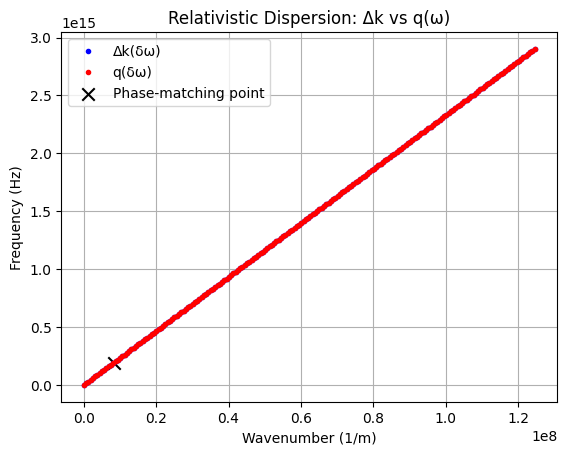

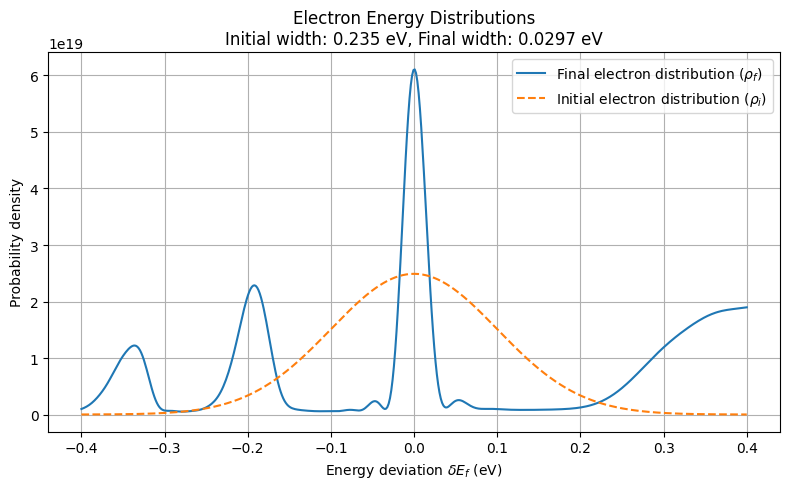

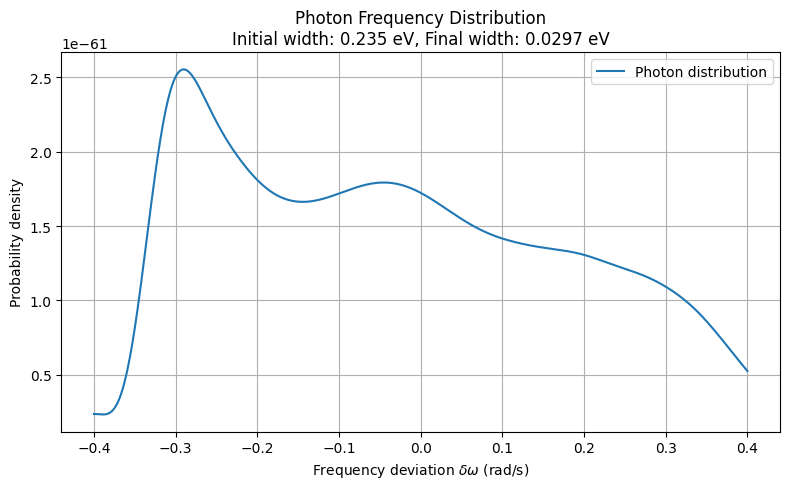

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 7 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 30

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 140.22it/s]


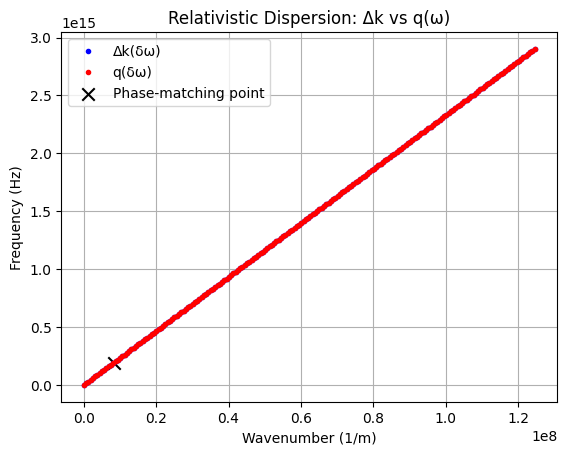

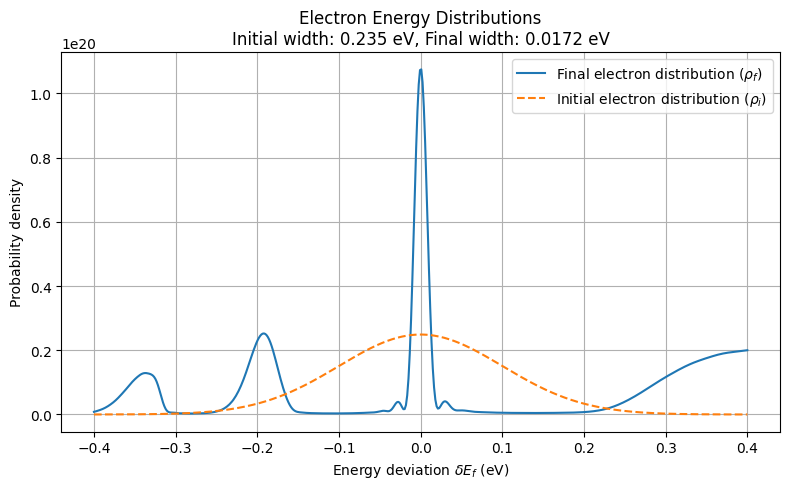

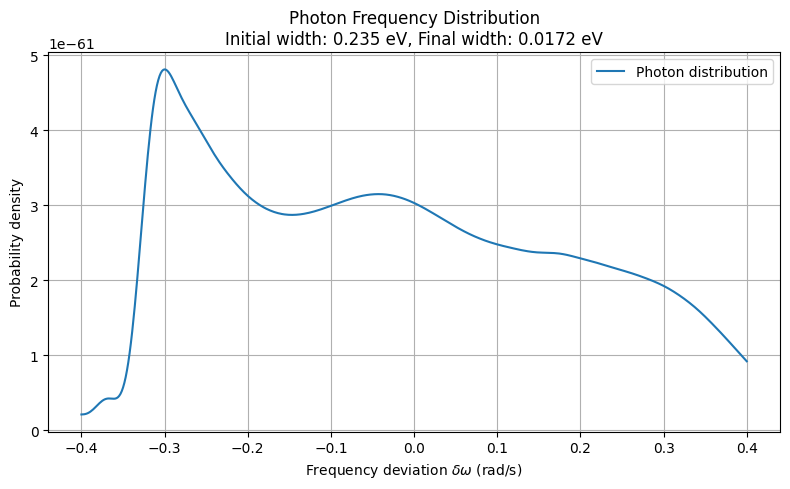

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 3 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 20

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 158.51it/s]


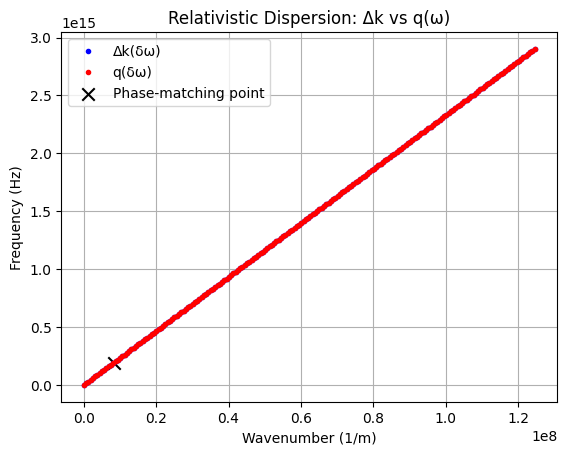

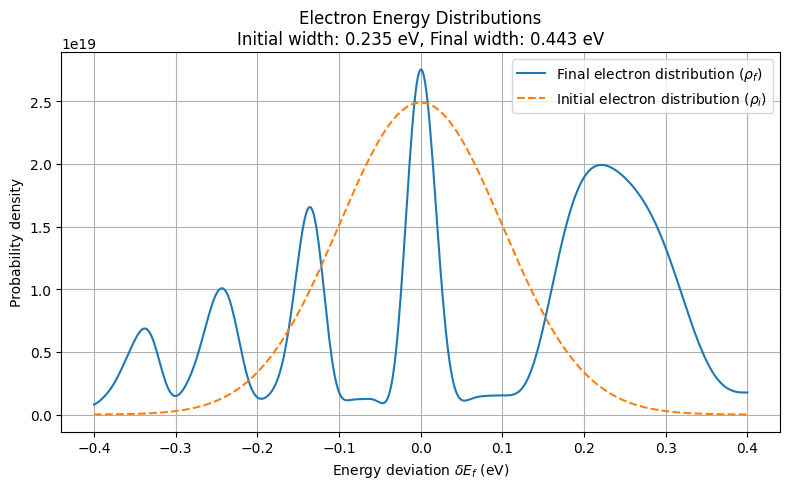

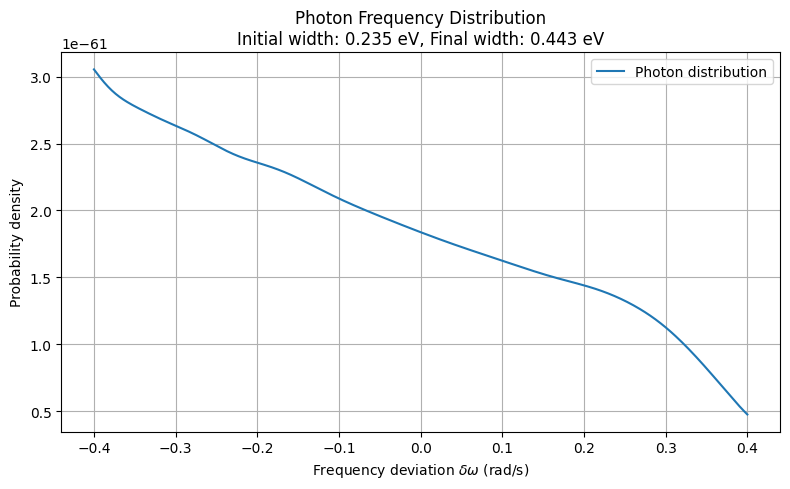

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 3 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 10

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 167.82it/s]


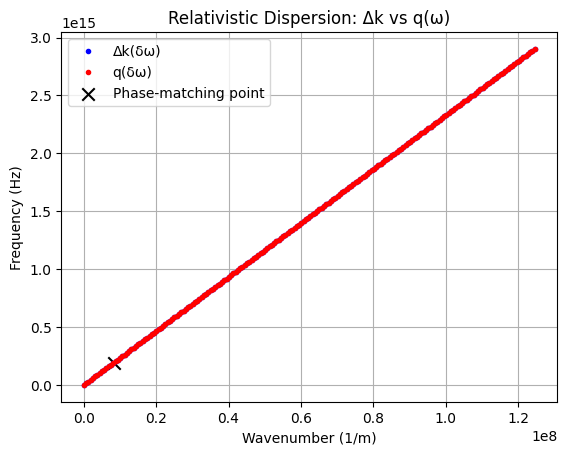

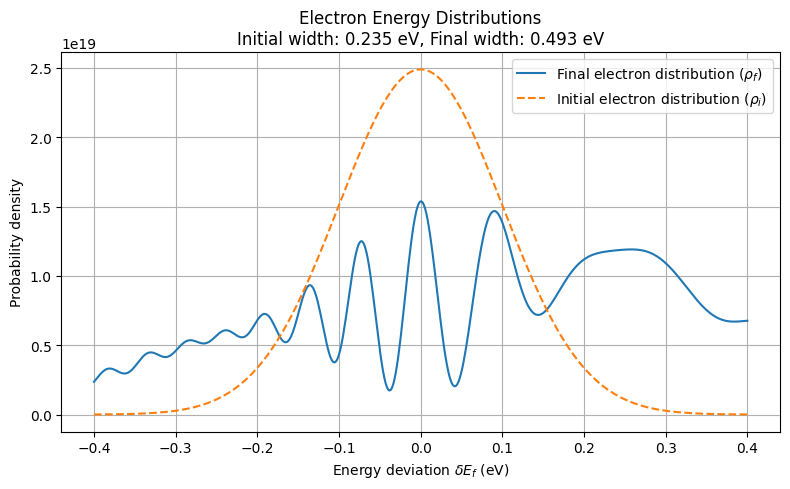

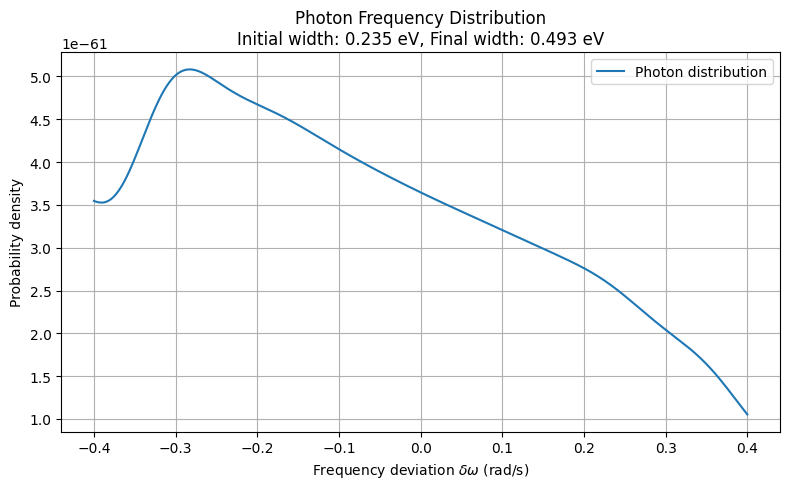

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 3 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 168.84it/s]


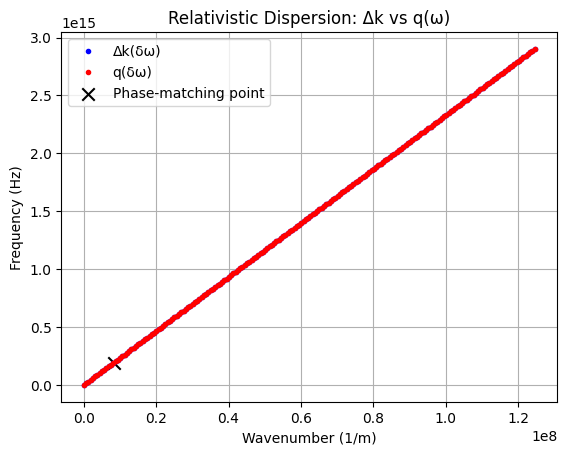

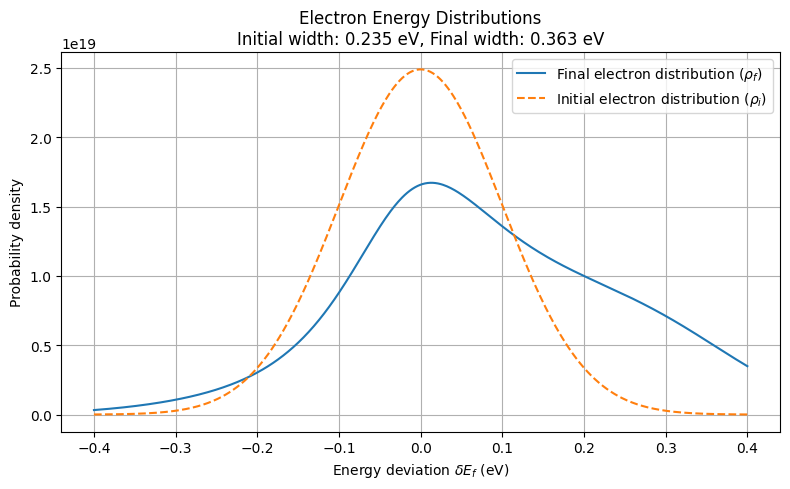

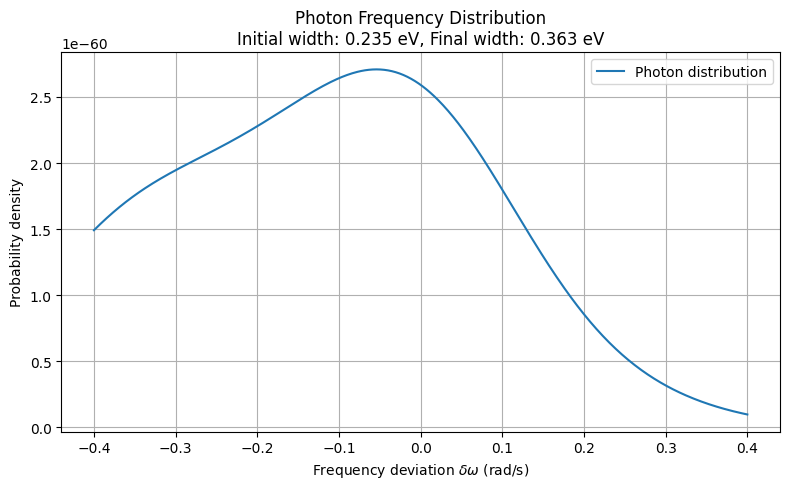

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 5
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor *  rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 2 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 164.23it/s]


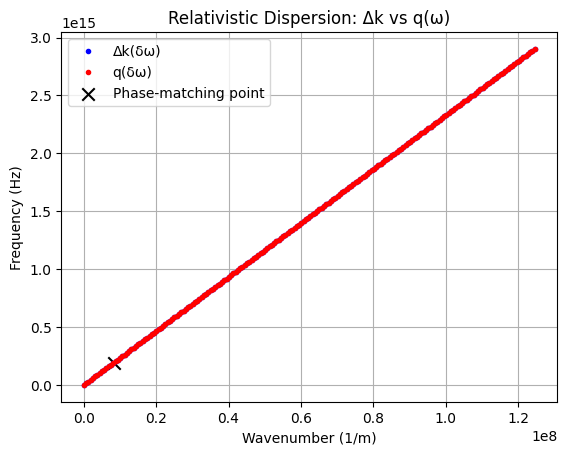

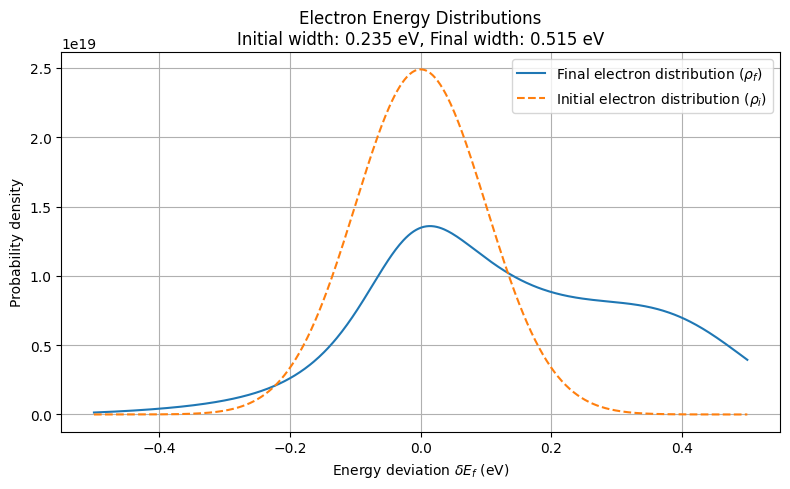

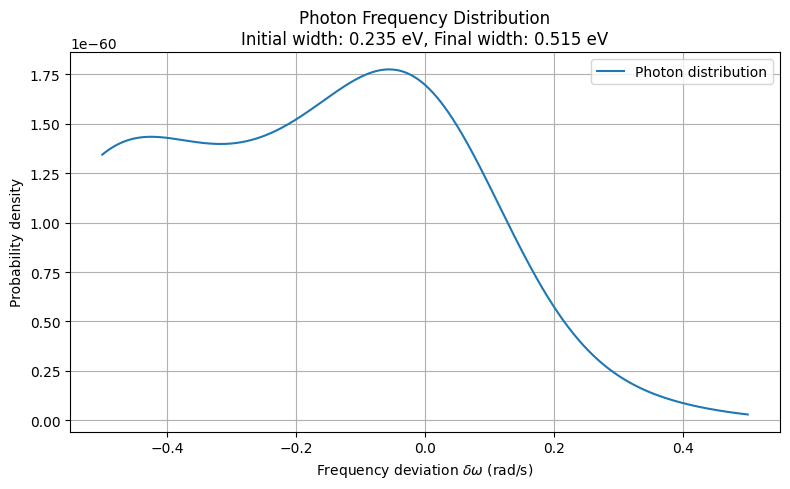

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 1 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 1

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:02<00:00, 171.97it/s]


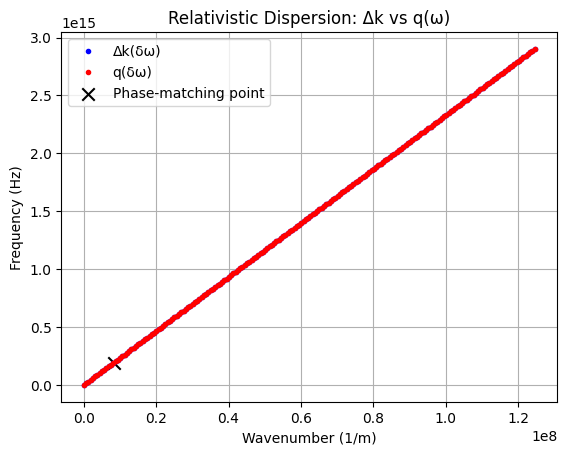

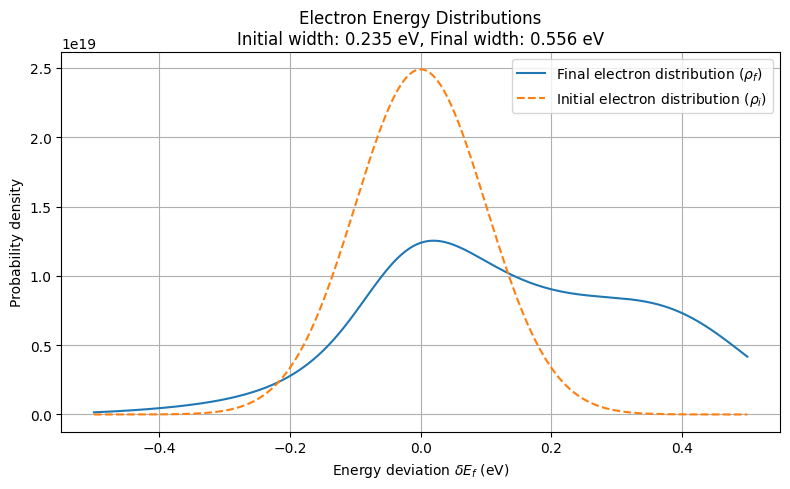

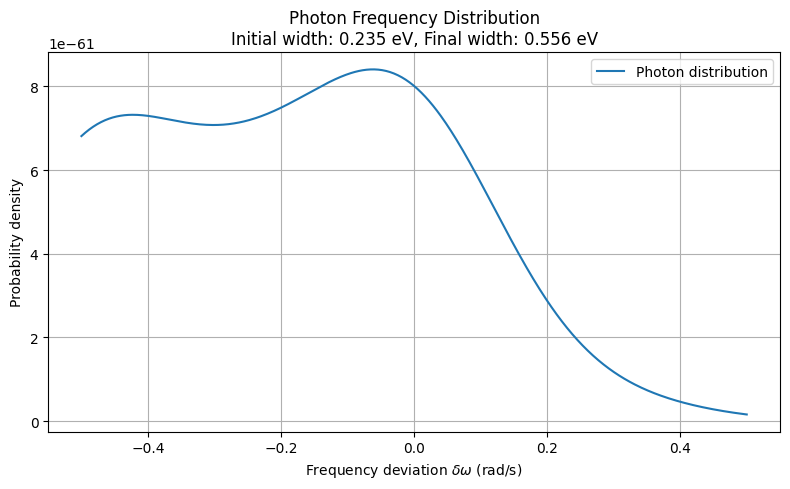

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 1 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 169.64it/s]


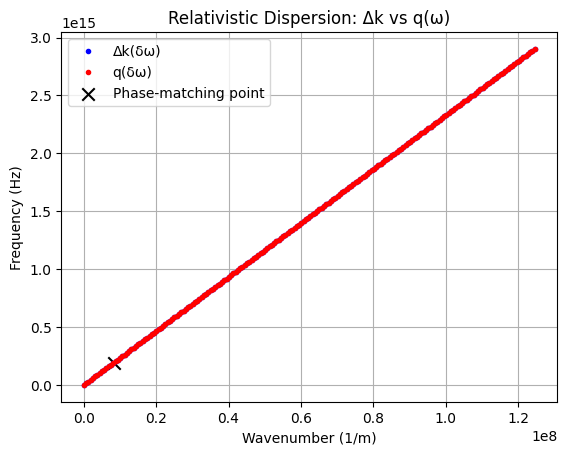

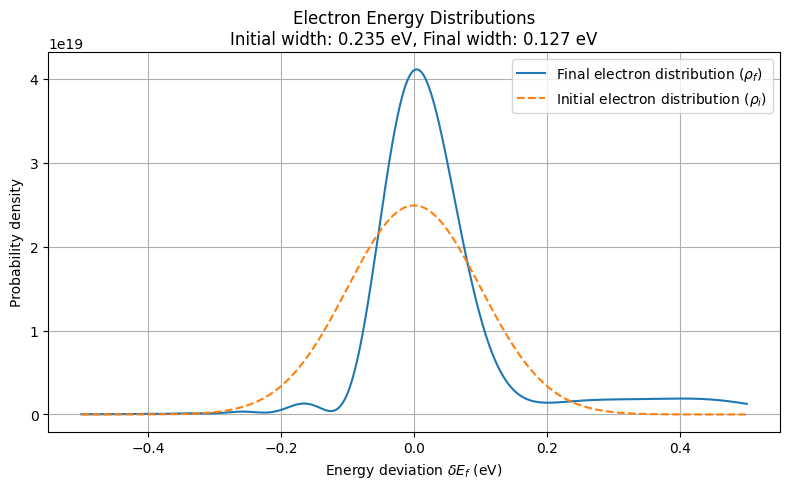

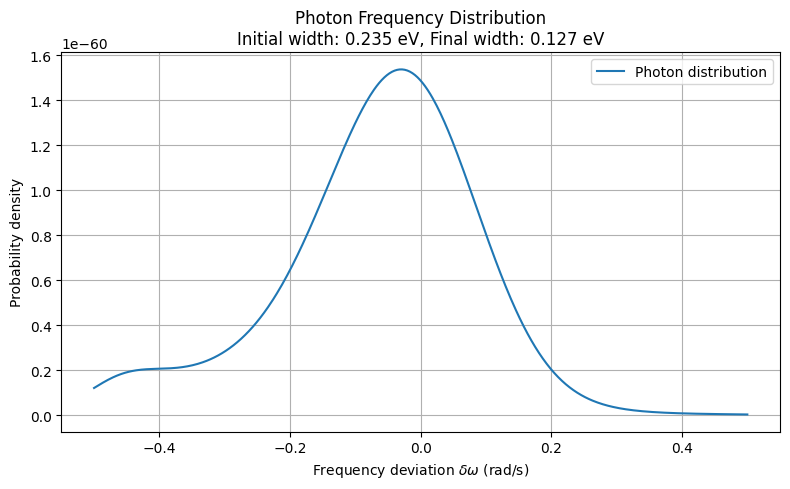

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 4 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:03<00:00, 157.92it/s]


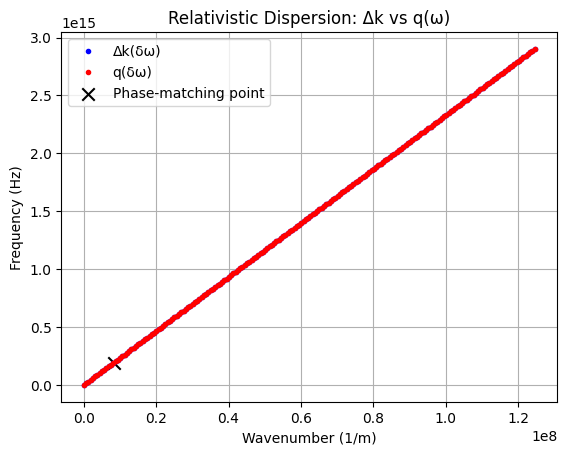

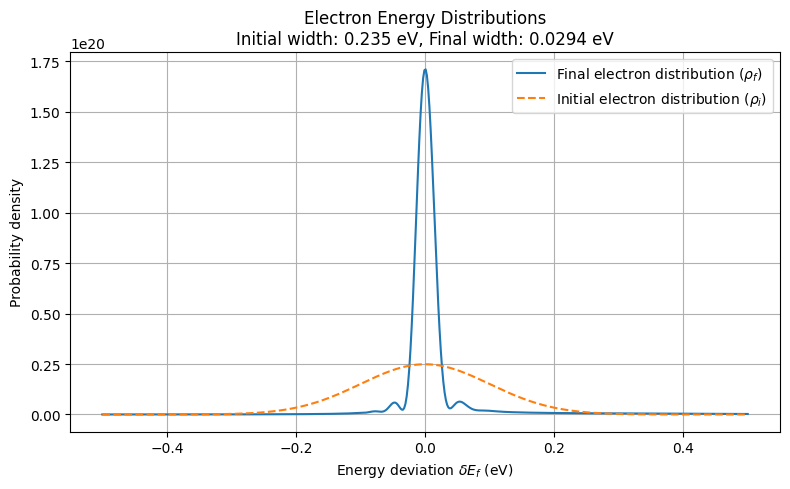

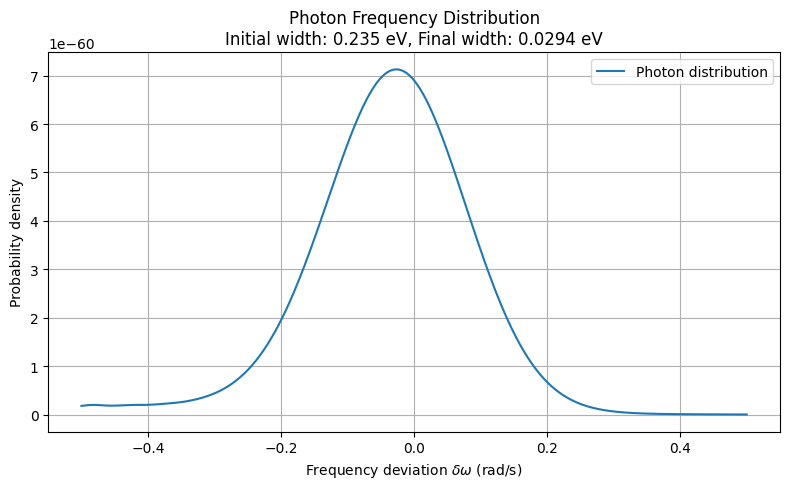

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
.

SyntaxError: invalid syntax (<ipython-input-143-a5d5b61aa8a6>, line 1)

In [ ]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from matplotlib import cm, colors
from tqdm import tqdm
from scipy.stats import linregress
from scipy.interpolate import interp1d
import os, csv
import pandas as pd
from pathlib import Path
from tabulate import tabulate

In [ ]:
from scipy.constants import c, m_e as m, hbar, e, epsilon_0 as eps0
import pandas as pd
from tabulate import tabulate
from tqdm import tqdm
from scipy.interpolate import interp1d
import csv

In [ ]:
# Definitions
def k(E):
    return np.sqrt(2 * m * E) / hbar
def k_rel(E):
    return np.sqrt(E**2 + 2 * E * (m * c**2)) / (hbar * c)
def E(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2  # in Joules
def E_eV(v0):
    """Calculate the energy of an electron with velocity v0."""
    return 0.5 * m * v0**2 / e  # in eV
def E_rel(v):
    """Calculate the relativistic energy of an electron with velocity v."""
    gamma = 1 / np.sqrt(1 - (v**2 / c**2))
    return (gamma - 1) * m * c**2
def v_rel(E_eV):
    """Calculate the relativistic velocity of an electron with energy E."""
    E = E_eV * e  # Convert eV to Joules
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)
def v_func(E):
    gamma = np.sqrt(1 + 2 * E / (m * c**2))
    return c * np.sqrt(1 - 1/gamma**2)

def λ(E_eV):
    E = E_eV * e  # Convert eV to Joules
    return 2*np.pi * hbar*c / E
def compute_FWHM(x, y):
    half = np.max(y) / 2.0
    above = np.where(y >= half)[0]
    if len(above) < 2:
        return 0.0
    return x[above[-1]] - x[above[0]]
def Δk(δE_f, E0, δω, omega0, k):
    return k(E0 + δE_f + hbar*(δω)) - k(E0 + δE_f - hbar*omega0)
    return {
        'c00': c00,  # constant term
        'c10': c10,  # coefficient of δE_f
        'c01': c01,  # coefficient of δω
        'c20': c20,  # coefficient of δE_f²
        'c11': c11,  # coefficient of δE_f*δω
        'c02': c02   # coefficient of δω²
    }
#  photon disperssion coefficients functions:
def q(δω,q0,vg,recoil):
    return q0 + (δω / vg) + 0.5 * recoil * δω**2
def q0_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    epsilon = hbar*omega0/E0
    zeta = gamma/(gamma+1)
    sigma = -1/(gamma + 1)**2
    return k0*(zeta*epsilon + sigma*epsilon**2)
def v_g_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    zeta = gamma/(gamma+1)
    return E0/(k0*hbar) *(1/zeta)
def recoil_func(omega0,v0):
    E0 = E_rel(v0)                                 # central electron energy (J)
    k0 = k_rel(E0)                                 # central electron wavenumber (rad/m)
    gamma  = np.sqrt(1/(1 - (v0/c)**2))
    sigma = -1/(gamma + 1)**2
    return  k0*hbar**2 *sigma/E0**2
def q0_CLASSICAL(omega0, v0):
    return omega0/v0 + 1/(2*k(E(v0))*(v0)**2)
def v_g_CLASSICAL(omega0, v0):
    return v0
def recoil_CLASSICAL(omega0, v0):
    return -1/((k(E(v0))*v0**2))
# numerical functions:
def nyquist_rate(v0,L_int,energy_span):
    gamma = np.sqrt(1/(1 - (v0/c)**2))
    E0 = E_rel(v0)
    k0 = k_rel(E0)
    return np.pi*E0**2 *(gamma+1)**2/(4*L_int*k0*energy_span*hbar)
# Density matrices
def final_state_probability_density(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm=0):
    grid_factor = 4
    sigmaE = sigmaE_eV * e  # eV → J

    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar  # rad/s


    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]

    energy_span = max(abs(δE_f))
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_e = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_e /= np.sum(rho_i_e) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    Delta_PM = (
        k_rel(E0 + δE_f_grid + hbar * δω_grid)
        - k_rel(E0 + δE_f_grid - hbar * omega0)
        - (q0 + (δω_grid / v_g) + 0.5 * recoil * δω_grid**2)
    )

    kernel = (hbar * k_rel(E0 + δE_f_grid + hbar * δω_grid) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

    factor = e**2 * hbar * L_int**2 / (2 * eps0 * (δω_grid + omega0))
    U_factor = 1 / 4.1383282083233256e-51
    rho_f = factor * U_factor * (rho_i_2d * kernel**2)

    # Electron marginal over ω (normalized over J)
    rho_f_e = np.sum(rho_f, axis=0) * dω
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e

    p1 = np.sum(rho_f_e * dE)

    # Photon marginal over δE_f (normalized over rad/s)
    rho_f_p = np.sum(rho_f, axis=1) * dE
    rho_f_p /= np.sum(rho_f_p * dω) if np.sum(rho_f_p * dω) != 0 else 1.0

    # Convert grids and distributions to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e
    rho_f_e_eV = rho_f_e / e
    rho_i_e_eV = rho_i_e / e

    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    return δE_f_eV, δω_eV, rho_f_e_eV, rho_i_e_eV, rho_f_p, final_width_eV, p1, L_eff

def final_state_probability_density_loss(N, L_int,sigmaE_eV,v0,omega0,v_g,recoil,gamma_dB_per_cm):
    grid_factor = 5
    
    sigmaE = sigmaE_eV * e 
    energy_span = grid_factor * sigmaE  # J
    omega_span = grid_factor * sigmaE / hbar
    
    δω = np.linspace(-omega_span, omega_span, N)
    dω = δω[1] - δω[0]
    δE_f = np.linspace(-energy_span, energy_span, N)  # J
    dE = δE_f[1] - δE_f[0]
    
    nyquist = nyquist_rate(v0, L_int, energy_span)
    if dω > nyquist:
        print(f"Warning: δω = {dω:.3e} > Nyquist rate = {nyquist:.3e} (aliasing may occur)")

    δω_grid, δE_f_grid = np.meshgrid(δω, δE_f, indexing="ij")
    rho_i_2d = np.exp(-((δE_f_grid + hbar * δω_grid) ** 2) / (2 * sigmaE**2)) / np.sqrt(2 * np.pi * sigmaE**2)
    i0 = np.argmin(np.abs(δω))
    K = np.zeros_like(δω)
    K[i0] = 1.0 / dω
    rho_i_1d = np.sum(rho_i_2d * K[:, None], axis=0) * dω  # equals rho_i_2d[i0, :]
    rho_i_1d /= np.sum(rho_i_1d) * dE

    k0 = k_rel(E0)
    k0_m_hw = k_rel(E0 - hbar * omega0)
    q0 = k0 - k0_m_hw  # phase matching

    # Losses and Lorentzian width
    alpha_np_per_cm = np.log(10)/10.0 * gamma_dB_per_cm   # power → Nepers (power)
    alpha_amp_per_cm = 0.5 * alpha_np_per_cm              # amplitude Nepers/cm
    alpha_np_per_m  = alpha_amp_per_cm * 100.0
    Gamma = v_g * alpha_np_per_m
    if Gamma <= 0:
        Gamma = 1e-24
    L_eff = v_g/Gamma if Gamma > 0 else L_int
    # Local u grid for Lorentzian integration (finer and narrower)
    U = min(4.0 * Gamma, omega_span)
    du_target = Gamma / 32.0  # Finer grid
    du = du_target if du_target > 0 else dω
    if du <= 0:
        du = dω
    M_side = max(1, int(np.ceil(U / du)))
    u = np.linspace(-M_side * du, M_side * du, 2 * M_side + 1)
    u_col = u[:, None]  # (M_u, 1)
    δE_col = δE_f[None, :]  # (1, N)

    # Initialize outputs
    rho_f_e = np.zeros_like(δE_f)  # Electron marginal
    rho_f_p = np.zeros_like(δω)  # Photon marginal
    
    for iω, ω in enumerate(tqdm(δω, desc=f"Scanning δω")):
        ωp = ω + u  # (M_u,)
        # Initial joint density ρ_i(E_f + ħω, E_f + ħω)
        rho_i_slice = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(
            -((δE_col + hbar * ω) ** 2) / (2 * sigmaE**2)
        )  # (1, N)

        # Phase mismatch Delta_PM (broadcasts to (M_u, N))
        Delta_PM = (
            k_rel(E0 + δE_col + hbar * ω)
            - k_rel(E0 + δE_col - hbar * omega0)
            - (q0 + (ωp[:, None] / v_g) + 0.5 * recoil * (ωp[:, None]**2))
        )

        kernel = (hbar * k_rel(E0 + δE_col + hbar * ω) / m) * np.sinc(Delta_PM * L_int / (2 * np.pi))

        factor = e**2 * hbar * L_int**2 / (2 * eps0 * (ωp[:, None] + omega0))
        

        # Lorentzian L_Γ(u) = L_Γ(ω' - ω)
        lorentz = (1 / np.pi) * (Gamma / 2.0) / ((u_col**2) + (Gamma / 2.0) ** 2)  # (M_u, 1)

        # Integrand (broadcasts lorentz to (M_u, N))
        integrand = factor *  rho_i_slice * kernel**2 * lorentz  # (M_u, N)

        # Integrate over u using Riemann sum
        integral_over_u = np.sum(integrand, axis=0) * du  # (N,)

        # Add to electron marginal (integrate over ω)
        rho_f_e += integral_over_u * dω

        # Photon marginal at this ω (integrate over E and u)
        rho_f_p[iω] = np.sum(integrand) * dE * du

    
    p1 = np.sum(rho_f_e * dE)
    
    # Normalize electron marginal
    rho_f_e /= np.sum(rho_f_e * dE) if np.sum(rho_f_e * dE) != 0 else 1.0
    final_width_eV = compute_FWHM(δE_f, rho_f_e) / e
    # Initial 1D distribution
    rho_i_e = (1 / np.sqrt(2 * np.pi * sigmaE**2)) * np.exp(-((δE_f) ** 2) / (2 * sigmaE**2))

    # Photon marginal over δE_f (normalized over rad/s)
    # (If you want photon marginal, sum over E for each ω)
    

    # Convert grids to eV
    δE_f_eV = δE_f / e
    δω_eV = hbar * δω / e

    # Return energy and frequency grids (in eV), final distributions, width, and p1
    return δE_f_eV, δω_eV, rho_f_e, rho_i_e, rho_f_p, final_width_eV, p1, L_eff
#plot functions:
def plot_v0_L_map(csv_path, initial_width, vg_fixed, E_rel, Loss):
    """
    Reads widths CSV (columns: L_int_m, v_0_m_per_s, width), builds a 2D map of
    W = log(final_width / initial_width), plots with blue=narrower, red=broader,
    and prints maximal narrowing stats incl. Energy-width ratio.
    """
    csv_path = Path(csv_path)
    if not csv_path.exists():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    # Read & coerce to numeric
    df = pd.read_csv(csv_path)
    for col in ["L_int_m", "v_0_m_per_s", "width"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

    # Average duplicates (if file is appended over multiple runs)
    df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

    # Compute W = log(final / initial)
    eps = np.finfo(float).tiny
    df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

    # Build grid that auto-fits the available (L, v0) points
    L_vals  = np.sort(df["L_int_m"].unique())
    v0_vals = np.sort(df["v_0_m_per_s"].unique())
    pivot   = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
    Z = np.ma.masked_invalid(pivot.to_numpy())

    # --- COLOR FIX: guarantee blue only for W<0 ---
    zmin = float(np.nanmin(Z))
    zmax = float(np.nanmax(Z))

    if zmin < 0 and zmax > 0:
        # Mixed signs → diverging, centered at 0
        absmax = float(np.nanmax(np.abs(Z)))
        if not np.isfinite(absmax) or absmax == 0.0:
            absmax = 1e-12
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=-absmax, vcenter=0.0, vmax=absmax)
        cmap = "RdBu_r"
    elif zmin >= 0:
        # All non-negative → use Reds (no blue exists)
        nrm = matplotlib.colors.Normalize(vmin=0.0, vmax=zmax if zmax > 0 else 1.0)
        cmap = "Reds"
    else:
        # All non-positive → use Blues_r
        nrm = matplotlib.colors.Normalize(vmin=zmin, vmax=0.0)
        cmap = "Blues_r"

    

    # ---- Maximal narrowing report ----
    # Find minimum final width and its (L, v0)
    # (Use the non-aggregated widths in the pivot-aligned grid)
    # Reconstruct corresponding widths_2D to match Z’s shape:
    width_pivot = (df.pivot(index="L_int_m", columns="v_0_m_per_s", values="width")
                     .reindex(index=L_vals, columns=v0_vals))
    widths_2D = width_pivot.to_numpy()
    if np.all(np.isnan(widths_2D)):
        print("No width data to summarize.")
        return

    min_idx_flat = np.nanargmin(widths_2D)
    min_i, min_j = np.unravel_index(min_idx_flat, widths_2D.shape)
    min_width = widths_2D[min_i, min_j]
    min_L_int = L_vals[min_i]
    min_v0    = v0_vals[min_j]

    # Electron kinetic energy at that v0 (nonrelativistic; use your own if needed)
    E_J  = E_rel(min_v0)  # in Joules
    E_eV = E_J / e

    print(f"Minimum width: {min_width:.6g} (same units as CSV 'width') "
          f"at L_int = {min_L_int:.6g} m, v_0 = {min_v0/c:.6g} c")
    energy_width_ratio = min_width / E_eV
    print(f"Energy-width ratio: {energy_width_ratio:.3e} (width / eV)")
    # Plot
    fig, ax = plt.subplots(figsize=(7.5, 5.5))
    im = ax.imshow(
        Z,
        origin="lower",
        aspect="auto",
        cmap=cmap,
        norm=nrm,
        extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
        interpolation="nearest"
    )
    ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
    ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")
    # Title with minimal energy-width ratio and Loss [dB/cm] if Loss > 1e-3
    title = rf"Min energy-width  = {energy_width_ratio:.3e}, $v_g^\mathrm{{fixed}}={vg_fixed/c:.6g}\ \mathrm{{c}}$"
    if Loss is not None and Loss > 1e-3:
        title += rf", Loss = {Loss:.2f} dB/cm"
    ax.set_title(title)

    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    # Nice sci formatting on v0 axis
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    plt.tight_layout()
    plt.show()
def plot_v0_Lmap_COMPARISSON(file1, file2, file3, file4, initial_width, titles, figsize=(24, 5.5)):
    """
    Plots 4 v0-L maps side by side for comparison with the same color scale.

    Parameters:
    - file1, file2, file3, file4: paths to CSV files
    - initial_width: initial width value for computing W = log(final/initial)
    - titles: list of 4 titles for each subplot (optional)
    - figsize: figure size tuple
    """

    def process_data(csv_path):
        """Helper function to process a single CSV file"""
        csv_path = Path(csv_path)
        if not csv_path.exists():
            raise FileNotFoundError(f"CSV not found: {csv_path}")

        # Read & coerce to numeric
        df = pd.read_csv(csv_path)
        for col in ["L_int_m", "v_0_m_per_s", "width"]:
            df[col] = pd.to_numeric(df[col], errors="coerce")
        df = df.dropna(subset=["L_int_m", "v_0_m_per_s", "width"])

        # Average duplicates
        df = df.groupby(["L_int_m", "v_0_m_per_s"], as_index=False).agg({"width": "mean"})

        # Compute W = log(final / initial)
        eps = np.finfo(float).tiny
        df["W"] = np.log(np.maximum(df["width"].to_numpy(), eps) / max(initial_width, eps))

        # Build grid
        L_vals = np.sort(df["L_int_m"].unique())
        v0_vals = np.sort(df["v_0_m_per_s"].unique())
        pivot = df.pivot(index="L_int_m", columns="v_0_m_per_s", values="W").reindex(index=L_vals, columns=v0_vals)
        Z = np.ma.masked_invalid(pivot.to_numpy())

        return Z, L_vals, v0_vals, df

    # Process all four datasets
    files = [file1, file2, file3, file4]
    datasets = []

    for file_path in files:
        Z, L_vals, v0_vals, df = process_data(file_path)
        datasets.append((Z, L_vals, v0_vals, df))

    # Find global min/max for consistent color scale
    all_Z_values = []
    for Z, _, _, _ in datasets:
        if not np.all(np.isnan(Z)):
            all_Z_values.extend(Z[~np.isnan(Z)].flatten())

    if not all_Z_values:
        raise ValueError("No valid data found in any of the files")

    global_zmin = np.min(all_Z_values)
    global_zmax = np.max(all_Z_values)

    # Set up normalization with global scale
    if global_zmin < 0 and global_zmax > 0:
        nrm = matplotlib.colors.TwoSlopeNorm(vmin=global_zmin, vcenter=0.0, vmax=global_zmax)
    else:
        nrm = matplotlib.colors.Normalize(vmin=global_zmin, vmax=global_zmax)

    cmap = "RdBu_r"  # Blue = narrower, Red = broader

    # Create subplots
    fig, axes = plt.subplots(1, 4, figsize=figsize, sharey=True)

    # Default titles if none provided
    if titles is None:
        titles = [f"Dataset {i+1}" for i in range(4)]

    images = []

    for i, (ax, (Z, L_vals, v0_vals, df), title) in enumerate(zip(axes, datasets, titles)):
        # Plot
        im = ax.imshow(
            Z,
            origin="lower",
            aspect="auto",
            cmap=cmap,
            norm=nrm,
            extent=[v0_vals.min(), v0_vals.max(), L_vals.min(), L_vals.max()],
            interpolation="nearest"
        )
        images.append(im)

        ax.set_xlabel(r"$v_0\ \mathrm{(m/s)}$")
        if i == 0:  # Only leftmost plot gets y-label
            ax.set_ylabel(r"$L_{\mathrm{int}}\ \mathrm{(m)}$")

        ax.set_title(title)
        ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

        # Print stats for each dataset
        print(f"\n--- {title} ---")
        if not np.all(np.isnan(Z)):
            min_W = np.nanmin(Z)
            max_W = np.nanmax(Z)
            print(f"W range: {min_W:.3f} to {max_W:.3f}")
        else:
            print("No valid data")

    # Add a single colorbar for all subplots
    fig.subplots_adjust(right=0.93)
    cbar_ax = fig.add_axes([0.94, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(images[0], cax=cbar_ax)
    cbar.set_label(r"$W=\log(\sigma_f/\sigma_i)$")

    plt.tight_layout()
    plt.subplots_adjust(right=0.93)
    plt.show()

    return fig, axes
def dispersion_plot(omega0, v0,v_g_function,recoil_function, E_function, k_function):
    # frequency grid around ω0
    omega_vec = np.linspace(0.005, 15, 200) * omega0
    δω_vec    = omega_vec - omega0

    # phase-matching linearization point (non-zero!)
    E0 = E_function(v0)                                 # central electron energy (J)
    q0_PM  = k_function(E0) - k_function(E0 - hbar*omega0)
    v_g     = v_g_function(omega0, v0)
    recoil = recoil_function(omega0, v0)

    k_diff_vec = Δk(0.0, E0, δω_vec, omega0, k_function)     # electron Δk(δω)
    q_vec      = q(δω_vec, q0_PM, v_g, recoil)           # photon q(δω)

    # Find index closest to phase-matching point (ω=ω0, k=q0_PM)
    idx_pm = np.argmin(np.abs(omega_vec - omega0))

    plt.figure()
    plt.plot(k_diff_vec, omega_vec/(2*np.pi), 'b.', label="Δk(δω)")
    plt.plot(q_vec,      omega_vec/(2*np.pi), 'r.', label="q(δω)")
    plt.scatter([q0_PM], [omega0/(2*np.pi)], color='k', marker='x', s=80, label="Phase-matching point")
    plt.xlabel("Wavenumber (1/m)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Relativistic Dispersion: Δk vs q(ω)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 4 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0"

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

SyntaxError: unterminated string literal (detected at line 11) (<ipython-input-147-fb6837d79f09>, line 11)

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 4 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:02<00:00, 203.80it/s]


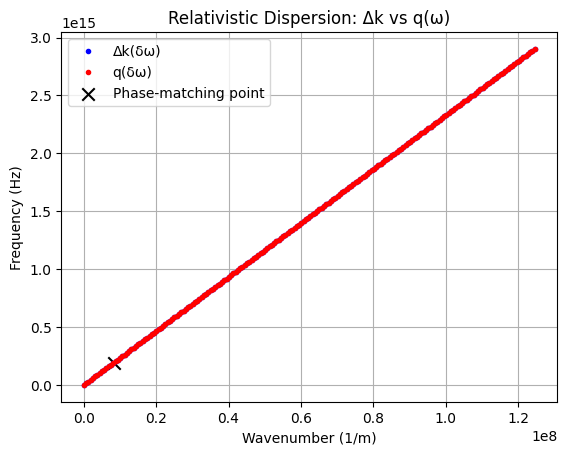

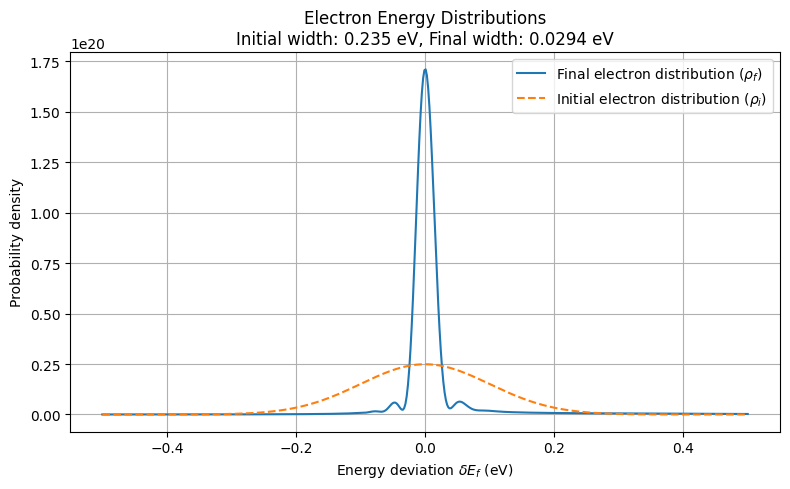

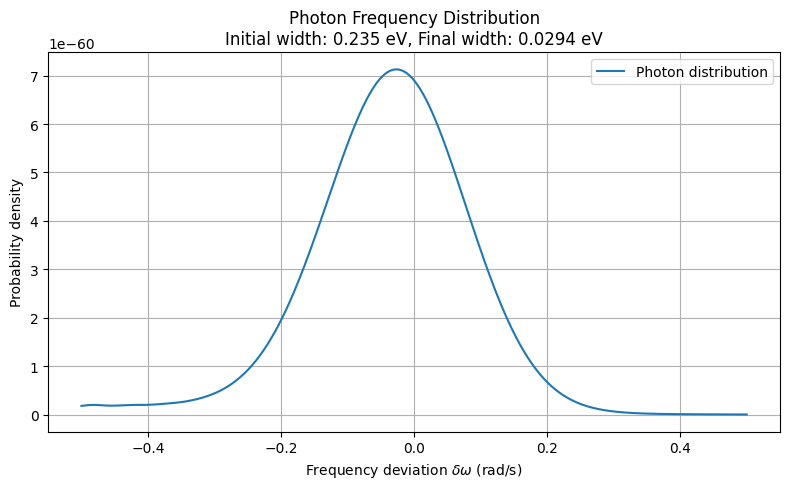

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**9
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 400 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 512/512 [00:02<00:00, 216.12it/s]


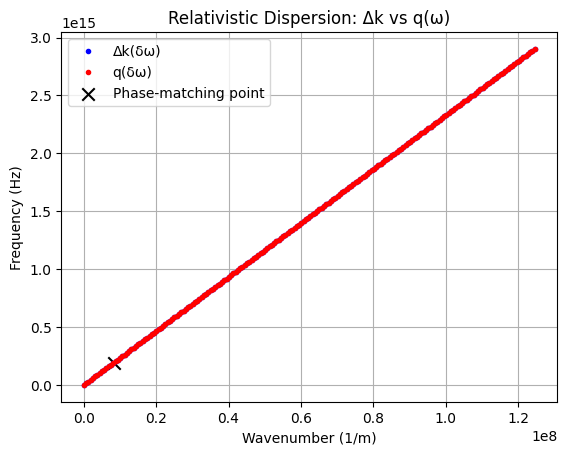

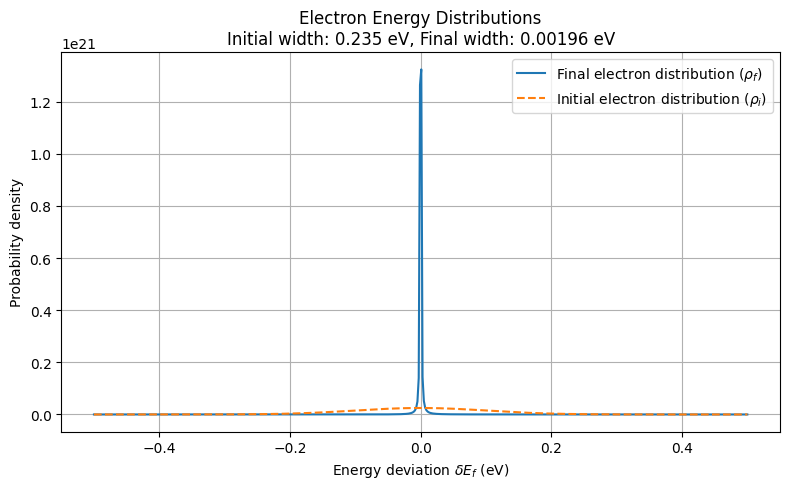

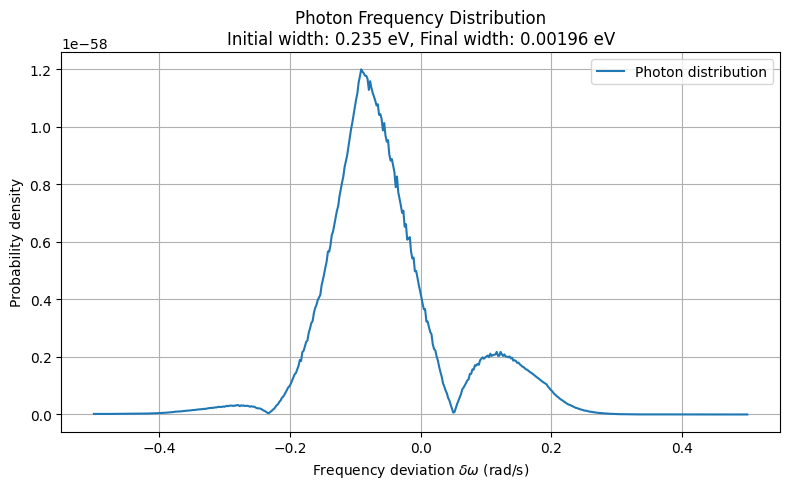

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
L_num = 21  # Number of interaction lengths to test
N = 2**11
L0 = 1.18 *  4  * (E0*v0 / (sigmaE*omega0))   # optimal interaction length
print(f"L0 = {L0:.4f} m")
L_int_vec = np.logspace(np.log10(0.0001), np.log10(0.1), L_num)  # m
loss_vec = [0, 30, 100, 200, 300, 400]  # dB/cm
widths_L = [[] for _ in range(len(loss_vec))]
for i, gamma_db_per_cm in enumerate(loss_vec):
    for L_int_test in tqdm(L_int_vec, desc="Scanning L_int", position=0):
        width, width_tot, p = final_state_probability_density_loss(N, L_int_test, gamma_db_per_cm)
        widths_L[i].append(width)  # Store final width in eV

L0 = 0.0000 m


Scanning L_int:   0%|          | 0/21 [00:00<?, ?it/s]


TypeError: final_state_probability_density_loss() missing 5 required positional arguments: 'v0', 'omega0', 'v_g', 'recoil', and 'gamma_dB_per_cm'

In [ ]:
N = 2**10
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 400 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω: 100%|██████████| 1024/1024 [00:09<00:00, 110.26it/s]


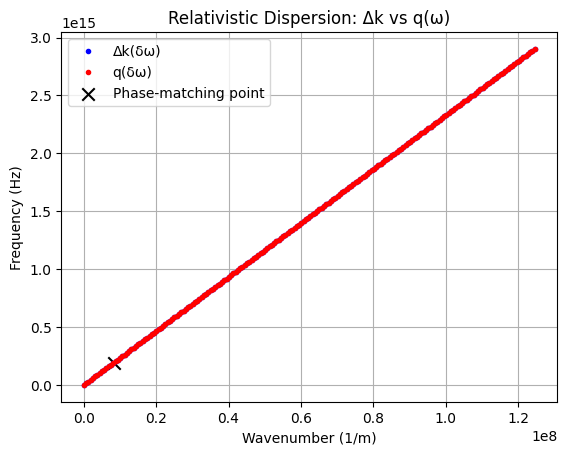

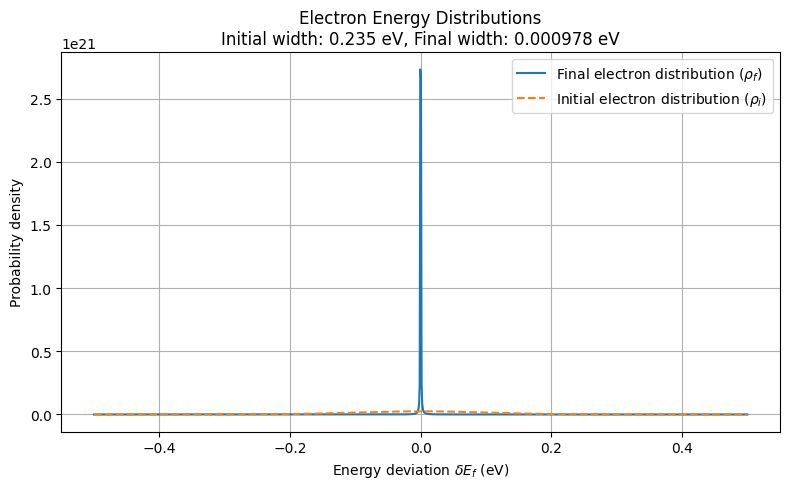

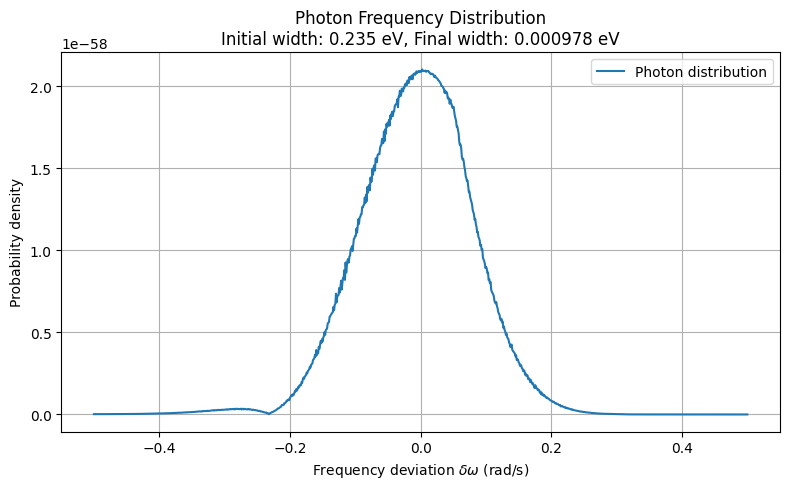

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
N = 2**12
v0 = v_rel(80e3)
E0 = E_rel(v0)


sigmaE = 100e-3  # eV
omega0 = 2 * np.pi * c / λ(0.8)  # central angular frequency (rad/s)
L_int = 400 # m
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2)) 
gamma_dB_per_cm = 0

L0 = 1.18*4*E0*v0/(sigmaE*omega0)

δE_f_eV, δω, rho_e, rho_e_initial, rho_f_p, final_width_eV, p1,L_eff = final_state_probability_density_loss(N,
                                                                                                            L_int,
                                                                                                            sigmaE,
                                                                                                            v0, omega0,
                                                                                                            v_g_func(omega0, v0),
                                                                                                            recoil_func(omega0, v0),
                                                                                                            gamma_dB_per_cm)

Scanning δω:   7%|▋         | 292/4096 [00:11<02:31, 25.05it/s]


KeyboardInterrupt: 

In [ ]:
dispersion_plot(
    omega0,
    v0,
    v_g_func,
    recoil_func,
    E_rel,
    k_rel
)
plt.figure(figsize=(8, 5))
plt.plot(δE_f_eV, rho_e, label="Final electron distribution ($\\rho_f$)")
plt.plot(δE_f_eV, rho_e_initial, label="Initial electron distribution ($\\rho_i$)", linestyle="--")
plt.xlabel("Energy deviation $\\delta E_f$ (eV)")
plt.ylabel("Probability density")
plt.title(f"Electron Energy Distributions\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot photon distribution
plt.figure(figsize=(8, 5))
plt.plot(δω, rho_f_p, label="Photon distribution")
plt.xlabel("Frequency deviation $\\delta\\omega$ (rad/s)")
plt.ylabel("Probability density")
plt.title(f"Photon Frequency Distribution\nInitial width: {initial_width:.3g} eV, Final width: {final_width_eV:.3g} eV")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

: 

In [ ]:
L_num = 21  # Number of interaction lengths to test
N = 2**8
L0 = 1.18 *  4  * (E0*v0 / (sigmaE*omega0))   # optimal interaction length
print(f"L0 = {L0:.4f} m")
L_int_vec = np.logspace(np.log10(0.0001), np.log10(0.1), L_num)  # m
loss_vec = [0, 30, 100, 200, 300, 400]  # dB/cm
widths_L = [[] for _ in range(len(loss_vec))]
for i, gamma_db_per_cm in enumerate(loss_vec):
    for L_int_test in tqdm(L_int_vec, desc="Scanning L_int", position=0):
        width, width_tot, p = final_state_probability_density_loss(N, L_int_test, gamma_db_per_cm)
        widths_L[i].append(width)  # Store final width in eV

L0 = 0.0000 m


Scanning L_int:   0%|          | 0/21 [00:00<?, ?it/s]


TypeError: final_state_probability_density_loss() missing 5 required positional arguments: 'v0', 'omega0', 'v_g', 'recoil', and 'gamma_dB_per_cm'

In [ ]:
L_num = 21  # Number of interaction lengths to test
N = 2**8
L0 = 1.18 *  4  * (E0*v0 / (sigmaE*omega0))   # optimal interaction length
print(f"L0 = {L0:.4f} m")
L_int_vec = np.logspace(np.log10(0.0001), np.log10(0.1), L_num)  # m
vg = v_g_func(omega0, v0)
recoil = recoil_func(omega0, v0)
loss_vec = [0, 30, 100, 200, 300, 400]  # dB/cm
widths_L = [[] for _ in range(len(loss_vec))]
for i, gamma_db_per_cm in enumerate(loss_vec):
    for L_int_test in tqdm(L_int_vec, desc="Scanning L_int", position=0):
        width, width_tot, p = final_state_probability_density_loss(N, L_int_test, sigmaE,v0,omega0, vg, recoil, gamma_db_per_cm)
        widths_L[i].append(width)  # Store final width in eV

L0 = 0.0000 m


Scanning L_int:   0%|          | 0/21 [00:00<?, ?it/s]


ValueError: too many values to unpack (expected 3)

In [ ]:
L_num = 21  # Number of interaction lengths to test
N = 2**8
L0 = 1.18 *  4  * (E0*v0 / (sigmaE*omega0))   # optimal interaction length
print(f"L0 = {L0:.4f} m")
L_int_vec = np.logspace(np.log10(0.0001), np.log10(0.1), L_num)  # m
vg = v_g_func(omega0, v0)
recoil = recoil_func(omega0, v0)
loss_vec = [0, 30, 100, 200, 300, 400]  # dB/cm
widths_L = [[] for _ in range(len(loss_vec))]
for i, gamma_db_per_cm in enumerate(loss_vec):
    for L_int_test in tqdm(L_int_vec, desc="Scanning L_int", position=0):
        width = final_state_probability_density_loss(N, L_int_test, sigmaE,v0,omega0, vg, recoil, gamma_db_per_cm)[2]
        widths_L[i].append(width)  # Store final width in eV

L0 = 0.0000 m


Scanning L_int: 100%|██████████| 21/21 [00:05<00:00,  3.97it/s]


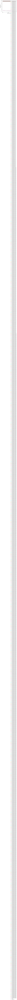

In [ ]:
plt.figure()
for i, gamma_db_per_cm in enumerate(loss_vec):
    # plt.plot(L_int_vec, np.array(widths_L[i]), ".-", label=f"Final Width {gamma_db_per_cm} dB/cm")
    plt.loglog(L_int_vec[:-4], np.array(widths_L[i])[:-4], ".-", label=f"Final Width {gamma_db_per_cm} dB/cm")


# plt.hlines(initial_width, L_int_vec[0], L_int_vec[-1], color="r", linestyle="--", label="Initial Width")
plt.loglog(L_int_vec[:-4], 1 / L_int_vec[:-4] / 5000, ".-", label="1/L_int")
# plt.vlines(L0, 0, max(widths_L) * 1.1, color="g", linestyle="--", label="L0")
plt.loglog(L_int_vec[:-4], 1 / np.sqrt(L_int_vec)[:-4] / 100, ".-", label="1/sqrt(L_int)")

# plt.ylim(0, initial_width * 1.1)
plt.ylabel("Final Width (eV)")
plt.xlabel("Interaction Length [m]")
plt.legend()
plt.show()

<ipython-input-161-4b8d861effc5>:9: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


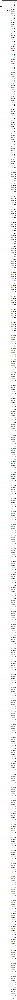

In [ ]:
plt.figure()
for i, gamma_db_per_cm in enumerate(loss_vec):
    plt.loglog(L_int_vec, np.array(widths_L[i]), ".-", label=f"Loss = {gamma_db_per_cm} dB/cm")
plt.loglog(L_int_vec, 1 / L_int_vec / 5000, "k--", label="1/L_int (guide)")
plt.loglog(L_int_vec, 1 / np.sqrt(L_int_vec) / 100, "r--", label="1/sqrt(L_int) (guide)")
plt.ylabel("Final Width (eV)")
plt.xlabel("Interaction Length [m]")
plt.legend()
plt.tight_layout()
plt.show()

<ipython-input-162-f5fb50b3b4e3>:12: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


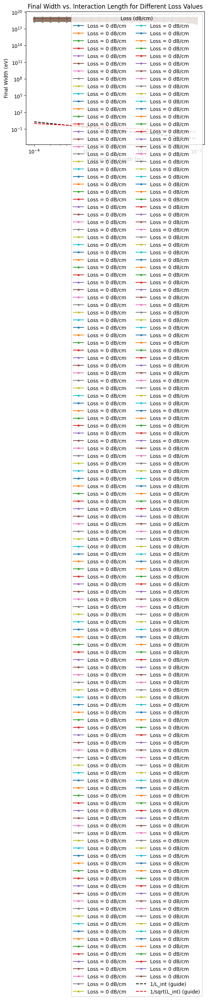

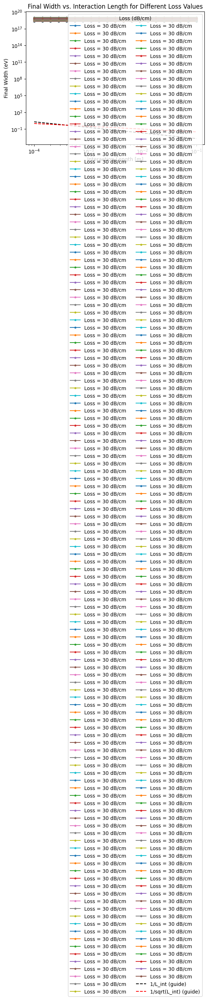

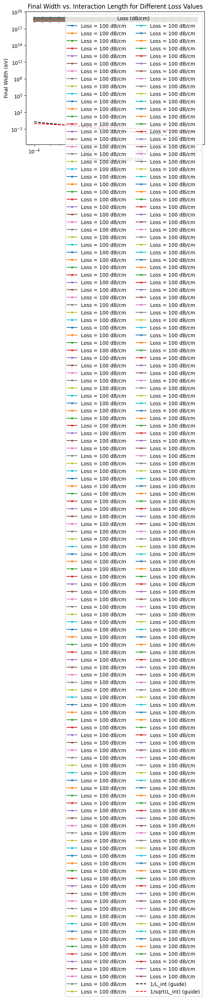

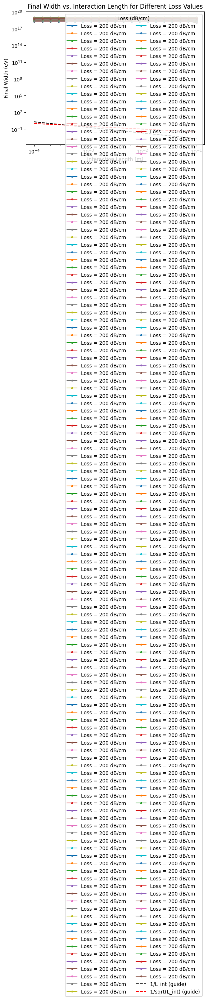

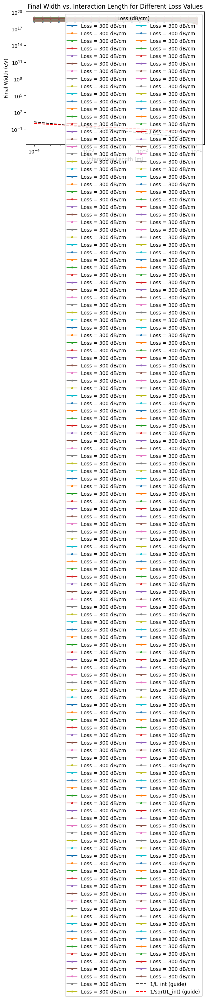

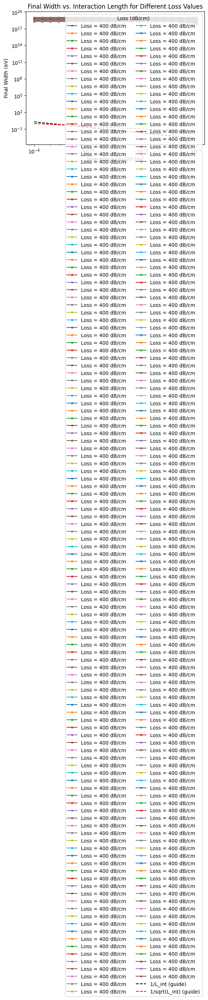

In [ ]:
plt.figure()
for i, gamma_db_per_cm in enumerate(loss_vec):
    plt.loglog(L_int_vec, np.array(widths_L[i]), ".-", label=f"Loss = {gamma_db_per_cm} dB/cm")
    plt.loglog(L_int_vec, 1 / L_int_vec / 5000, "k--", label="1/L_int (guide)")
    plt.loglog(L_int_vec, 1 / np.sqrt(L_int_vec) / 100, "r--", label="1/sqrt(L_int) (guide)")
    plt.ylabel("Final Width (eV)")
    plt.xlabel("Interaction Length [m]")
    plt.legend(title="Loss (dB/cm)", loc="best", ncol=2)
    plt.xscale("log")
    plt.yscale("log")
    plt.title("Final Width vs. Interaction Length for Different Loss Values")
    plt.tight_layout()
    plt.show()

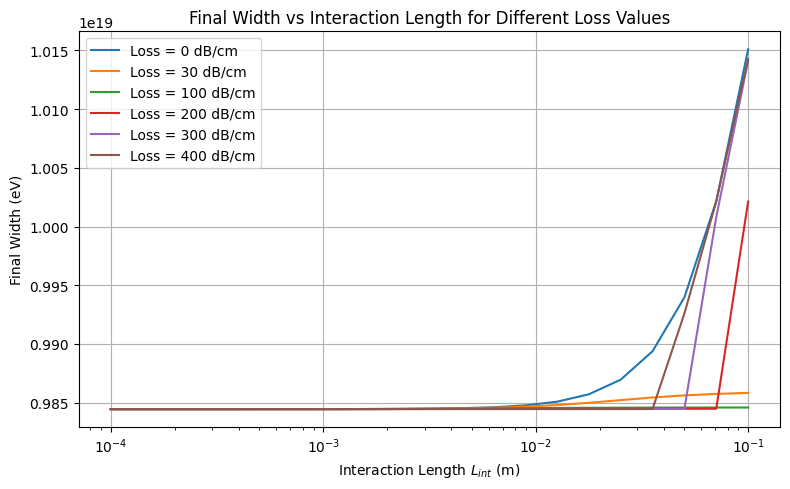

In [ ]:
plt.figure(figsize=(8, 5))
for i, gamma_db_per_cm in enumerate(loss_vec):
    plt.plot(L_int_vec, [np.max(w) if isinstance(w, np.ndarray) else w for w in widths_L[i]], label=f"Loss = {gamma_db_per_cm} dB/cm")
plt.xlabel("Interaction Length $L_{int}$ (m)")
plt.ylabel("Final Width (eV)")
plt.title("Final Width vs Interaction Length for Different Loss Values")
plt.xscale("log")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

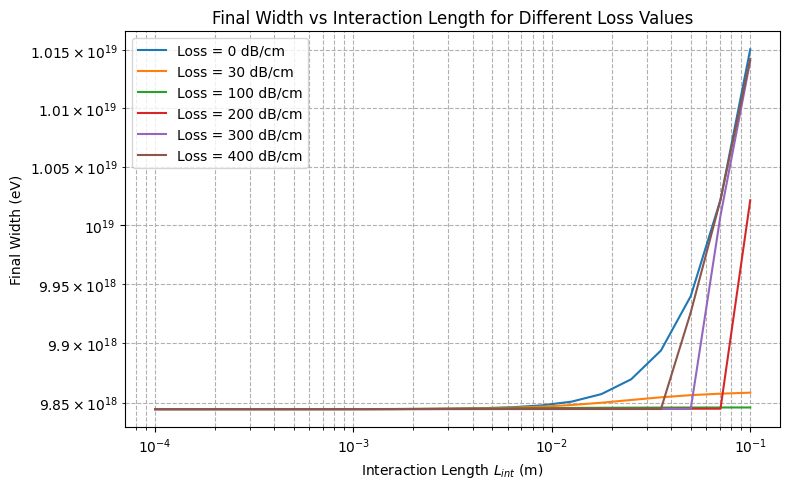

In [ ]:
plt.figure(figsize=(8, 5))
for i, gamma_db_per_cm in enumerate(loss_vec):
    plt.plot(L_int_vec, [np.max(w) if isinstance(w, np.ndarray) else w for w in widths_L[i]], label=f"Loss = {gamma_db_per_cm} dB/cm")
plt.xlabel("Interaction Length $L_{int}$ (m)")
plt.ylabel("Final Width (eV)")
plt.title("Final Width vs Interaction Length for Different Loss Values")
plt.xscale("log")
plt.yscale("log")
plt.legend()
plt.grid(True, which="both", ls="--")
plt.tight_layout()
plt.show()

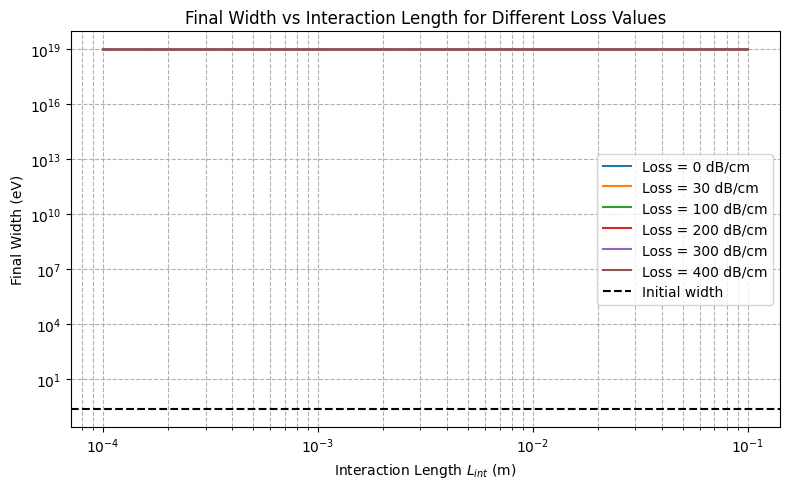

In [ ]:
plt.figure(figsize=(8, 5))
for i, gamma_db_per_cm in enumerate(loss_vec):
    plt.plot(L_int_vec, [np.max(w) if isinstance(w, np.ndarray) else w for w in widths_L[i]], label=f"Loss = {gamma_db_per_cm} dB/cm")
plt.axhline(initial_width, color='k', linestyle='--', label='Initial width')
plt.xlabel("Interaction Length $L_{int}$ (m)")
plt.ylabel("Final Width (eV)")
plt.title("Final Width vs Interaction Length for Different Loss Values")
plt.xscale("log")
plt.yscale("log")
plt.legend()
plt.grid(True, which="both", ls="--")
plt.tight_layout()
plt.show()

In [ ]:
initial_width = sigmaE * 2 * np.sqrt(2 * np.log(2))

In [ ]:
L_num = 21  # Number of interaction lengths to test
N = 2**8
L0 = 1.18 *  4  * (E0*v0 / (sigmaE*omega0))   # optimal interaction length
print(f"L0 = {L0:.4f} m")
L_int_vec = np.logspace(np.log10(0.1), np.log10(10), L_num)  # m
vg = v_g_func(omega0, v0)
recoil = recoil_func(omega0, v0)
loss_vec = [0, 3, 5, 20, 30, 40]  # dB/cm
widths_L = [[] for _ in range(len(loss_vec))]
for i, gamma_db_per_cm in enumerate(loss_vec):
    for L_int_test in tqdm(L_int_vec, desc="Scanning L_int", position=0):
        width = final_state_probability_density_loss(N, L_int_test, sigmaE,v0,omega0, vg, recoil, gamma_db_per_cm)[2]
        widths_L[i].append(width)  # Store final width in eV

L0 = 0.0000 m


Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  4.05it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:04<00:00,  4.06it/s]

Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  4.11it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:04<00:00,  4.19it/s]

Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  3.80it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:05<00:00,  3.95it/s]

Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  3.86it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:04<00:00,  3.84it/s]

Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  3.84it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:05<00:00,  3.75it/s]

Scanning L_int:  90%|█████████ | 19/21 [00:04<00:00,  3.79it/s]

Scanning L_int:  95%|█████████▌| 20/21 [00:05<00:00,  4.01it/s]

Scanning L_int: 100%|██████████| 21/21 [00:05<00:00,  3.93it/s]
